In [22]:
library(targets)
library(tidyverse)
library(Seurat)
library(spacexr)

In [2]:
source('resolve_cellbender.R')

In [10]:
make_RCTD_ref = function(obj, ident){
    Idents(obj) <- ident
    allowed_idents = obj %>% `[[` %>% group_by(.data[[ident]]) %>% summarise(n=n()) %>% filter(n >=25) %>% select(-n) %>% pull
    selected_cells = obj %>% `[[` %>% filter(.data[[ident]] %in% allowed_idents) %>% rownames
    obj = obj %>% subset(cells = selected_cells )
    counts <- GetAssayData(obj, assay = "RNA", slot = "counts")
    cluster <- obj[[ident]] %>% rownames_to_column %>% deframe %>% as.factor
    nUMI <- obj[['nCount_RNA']] %>% rownames_to_column %>% deframe
    nUMI <- colSums(counts)
    reference <- Reference(counts, cluster, nUMI)
    reference
}

In [11]:
make_RCTD_query = function(xe_obj, fov){
    query.counts <- GetAssayData(xe_obj, assay = "Xenium", slot = "counts")[, Cells(xe_obj[[fov]])]
    coords <- GetTissueCoordinates(xe_obj[[fov]], which = "centroids")
    rownames(coords) <- coords$cell
    coords$cell <- NULL
    query <- SpatialRNA(coords, query.counts, colSums(query.counts))
    query
}

In [12]:
get_rctd_annotations_df = function(rctd){
    rctd %>% `@`('results') %>% `$`('results_df')
}

In [250]:
label_transfer_to_fov = function(xe_obj, rctd_ref, fov, confidence_threshold = 5, doublet_threshold=20){
    fov_annot = xe_obj %>% 
        make_RCTD_query(fov) %>%
        create.RCTD(rctd_ref, max_cores = 4, CONFIDENCE_THRESHOLD = confidence_threshold, DOUBLET_THRESHOLD=doublet_threshold) %>%
        run.RCTD(doublet_mode = "doublet") %>%
        get_rctd_annotations_df
    fov_annot
}

In [251]:
run_rctd = function(xe_obj, ref_obj, transfer_col, confidence_threshold = 5, doublet_threshold=20){
    rctd_ref = make_RCTD_ref(ref_obj, transfer_col)
    fov.1_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.2_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.2', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.3_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.3', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.4_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.4', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.5_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.5', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.6_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.6', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.7_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.7', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    fov.8_annot = label_transfer_to_fov(xe_obj, rctd_ref, 'fov.8', confidence_threshold = confidence_threshold, doublet_threshold=doublet_threshold)
    annot_df = bind_rows(fov.1_annot,
                         fov.2_annot,
                         fov.3_annot,
                         fov.4_annot,
                         fov.5_annot,
                         fov.6_annot,
                         fov.7_annot,
                         fov.8_annot)
    annot_df
}

In [303]:
?create.RCTD

create.RCTD {spacexr},R Documentation
spatialRNA,a SpatialRNA object to run RCTD on
reference,a Reference object scRNA-seq reference used for RCTD
max_cores,"for parallel processing, the number of cores used. If set to 1, parallel processing is not used. The system will additionally be checked for number of available cores."
gene_cutoff,minimum normalized gene expression for genes to be included in the platform effect normalization step.
fc_cutoff,minimum log-fold-change (across cell types) for genes to be included in the platform effect normalization step.
gene_cutoff_reg,minimum normalized gene expression for genes to be included in the RCTD step.
fc_cutoff_reg,minimum log-fold-change (across cell types) for genes to be included in the RCTD step.
UMI_min,minimum UMI per pixel included in the analysis
UMI_max,maximum UMI per pixel included in the analysis
counts_MIN,(default 10) minimum total counts per pixel of genes used in the analysis.


In [15]:
xe_obj = qs::qread('_targets/objects/obj_merged') %>% process_xenium
xe_obj

Normalizing layer: counts

Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
PC_ 1 
Positive:  Aqp4, Slc7a11, Bmp4, Cfap299, Pdgfra, Lrmda, Rax, Agrp, Slc1a2, Pdzrn3 
	   Htr3b, Plp1, Csmd1, Pcdh11x, Lef1, Rgs6, Gpc5, Naaladl2, Pomc, Immp2l 
	   Fhit, P3h2, Luzp2, Il1rapl2, Sox5, Trpm3, Ntm, Erbb4, Adarb2, Gpc6 
Negative:  Nrg3, Fam155a, Ctnna2, Grm7, Tenm2, Cacna2d3, Dlg2, Pde10a, Gabrg3, Lrp1b 
	   Ncam2, Brinp3, Rbfox1, Dcc, Ptprd, Nrxn3, Kcnq3, Oxr1, Lingo2, Kcnip4 
	   Tenm3, Grm8, Pcdh7, Gria1, Wwox, Prkca, Fgf13, Sorcs1, Cntn5, Nrg1 
PC_ 2 
Positive:  Tenm2, Rbfox1, Hs3st4, Kcnip4, Nrg3, Grm8, Lingo2, Grm7, Dlg2, Fam155a 
	   Nrxn3, Cntn5, Car10, Fgf13, Sgcz, Cntn4, Ctnna2, Pde10a, Nxph1, Kcnq3 
	   Arhgap6, Col25a1, Galntl6, Dcc, Nkain2, Kctd16, Macrod2, Cacna2d3, Gabrg3, Prkg1 
Negative:  Aqp4, Slc7a11, Trpm3, Gpc5, Sox5, Rgs6, Slc1a2, G

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 119775
Number of edges: 4299482

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8854
Number of communities: 581
Elapsed time: 37 seconds


482 singletons identified. 99 final clusters.

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
UMAP will return its model

00:57:51 UMAP embedding parameters a = 0.9922 b = 1.112

00:57:51 Read 119775 rows and found 99 numeric columns

00:57:51 Using Annoy for neighbor search, n_neighbors = 30

00:57:51 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

00:58:23 Writing NN index file to temp file /scratch/nmq407/R_tmp//RtmpH1KKNX/file7c842ebb1a51

00:58:23 Searching Annoy index using 1 thread, search_k = 3000

01:00:47 Annoy recall = 94.6

An object of class Seurat 
400 features across 119775 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

In [16]:
ref_obj = qs::qread('_targets/objects/obj_d5_01')
ref_obj

An object of class Seurat 
27934 features across 50188 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [ ]:
annot_df = run_rctd(xe_obj, ref_obj, 'cell_class')

Warning message in Reference(counts, cluster, nUMI):
“Reference: number of cells per cell type is 39574, larger than maximum allowable of 10000. Downsampling number of cells to: 10000”
Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 20000

process_cell_type_info: number of genes in reference: 25934




neuron  other 
 10000  10000 


Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: neuron found DE genes: 32

get_de_genes: other found DE genes: 24

get_de_genes: total DE genes: 56

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: neuron found DE genes: 41

get_de_genes: other found DE genes: 31

get_de_genes: total DE genes: 72

fitBulk: decomposing bulk

chooseSigma: using initial Q_mat with sigma =  1

Likelihood value: 116090.460884331

Sigma value:  1



[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"
[1] "gather_results: finished 5000"
[1] "gather_results: finished 6000"
[1] "gather_results: finished 7000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 20000

process_cell_type_info: number of genes in reference: 25934




neuron  other 
 10000  10000 


Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: neuron found DE genes: 32

get_de_genes: other found DE genes: 24

get_de_genes: total DE genes: 56

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: neuron found DE genes: 41

get_de_genes: other found DE genes: 31

get_de_genes: total DE genes: 72

fitBulk: decomposing bulk

chooseSigma: using initial Q_mat with sigma =  1

Likelihood value: 117276.889321814

Sigma value:  0.98

Likelihood value: 117267.313547256

Sigma value:  0.98



[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"
[1] "gather_results: finished 5000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 20000

process_cell_type_info: number of genes in reference: 25934




neuron  other 
 10000  10000 


Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: neuron found DE genes: 32

get_de_genes: other found DE genes: 24

get_de_genes: total DE genes: 56

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: neuron found DE genes: 41

get_de_genes: other found DE genes: 31

get_de_genes: total DE genes: 72

fitBulk: decomposing bulk

chooseSigma: using initial Q_mat with sigma =  1

Likelihood value: 119001.207423245

Sigma value:  0.96

Likelihood value: 118962.092110036

Sigma value:  0.96



[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"
[1] "gather_results: finished 5000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 20000

process_cell_type_info: number of genes in reference: 25934




neuron  other 
 10000  10000 


Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.9 GiB”
End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: neuron found DE genes: 32

get_de_genes: other found DE genes: 24

get_de_genes: total DE genes: 56

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: neuron found DE genes: 41

get_de_genes: other found DE genes: 31

get_de_genes: total DE genes: 72

fitBulk: decomposing bulk

chooseSigma: using initial Q_mat with sigma =  1

Likelihood value: 118859.376021339

Sigma value:  0.98

Likelihood value: 118842.958256112

Sigma value:  0.96

Likelihood value: 118839.825506231

Sigma value:  0.96



In [270]:
annot_df %>% group_by(spot_class) %>% summarise(n=n())

spot_class,n
<fct>,<int>
singlet,47830
doublet_certain,405


In [95]:
obj = xe_obj %>% 
AddMetaData(annot_df %>% rename_with(~paste0(., "_cell_class")))

In [96]:
selected_cells = obj %>% `[[` %>% filter(!is.na(spot_class_cell_class)) %>% filter(spot_class_cell_class == 'singlet') %>% rownames

In [97]:
obj = obj %>% subset(cells = selected_cells) %>% subset(subset = cell_area <= 10000)
obj

Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating

An object of class Seurat 
400 features across 47622 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

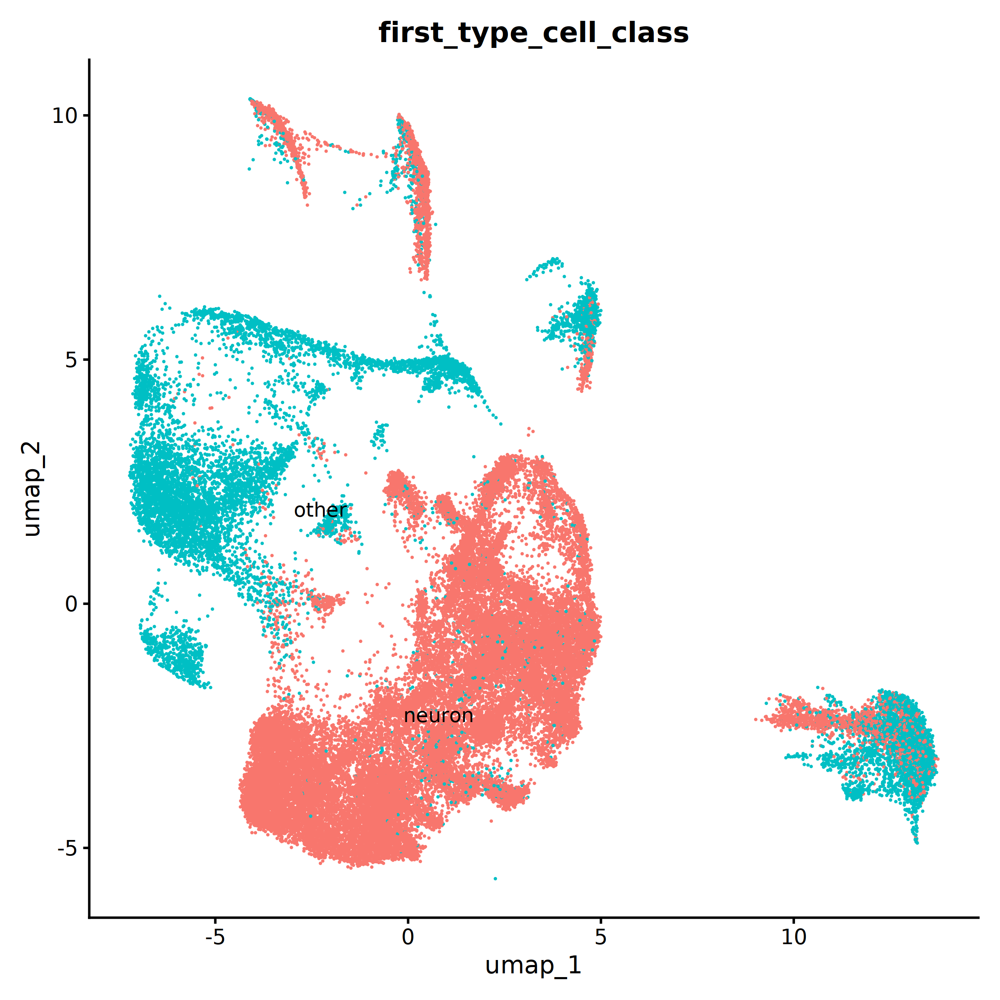

In [98]:
options(repr.plot.width=8, repr.plot.height=8, repr.plot.res=300)
DimPlot(obj, group.by = 'first_type_cell_class', label=TRUE) + NoLegend()

In [124]:
xe_obj_cca_td_2s = qs::qread('_targets/objects/xe_obj_cca_td_2s')
xe_obj_cca_td_2s

An object of class Seurat 
400 features across 38520 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: scale.data, data, counts
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 15 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8 fov.2.2 fov.3.2 fov.4.2 fov.5.2 fov.6.2 fov.7.2 fov.8.2

In [125]:
meta = xe_obj_cca_td_2s %>% `[[`
meta

,orig.ident,nCount_Xenium,nFeature_Xenium,nCount_BlankCodeword,nFeature_BlankCodeword,nCount_ControlCodeword,nFeature_ControlCodeword,nCount_ControlProbe,nFeature_ControlProbe,cell_area,⋯,treatment,strain,time,seurat_clusters,class,cell_class,polar_label,polar_label_prediction.score.max,labels,labels_prediction.score.max
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,⋯,<chr>,<chr>,<chr>,<fct>,<chr>,<chr>,<chr>,<dbl>,<chr>,<dbl>
Cell10000_9129_13312_1,SeuratProject,113,38,0,0,0,0,0,0,1271,⋯,Veh_PF,obob,obob,18,neuron,neuron,Nfix__Nfib__Lhx6.none,0.5627680,Nfix__Nfib__Lhx6,2
Cell10008_4292_3239_1,SeuratProject,115,37,0,0,0,0,0,0,1989,⋯,Veh_PF,obob,obob,8,neuron,neuron,Lepr15.none,0.3147024,Lepr15,2
Cell10019_6171_751_1,SeuratProject,128,36,0,0,0,0,0,0,2110,⋯,Veh_PF,obob,obob,15,neuron,neuron,Trh__Cxcl12.none,0.8755183,Trh__Cxcl12,2
Cell10021_10259_2827_1,SeuratProject,122,44,0,0,0,0,0,0,2420,⋯,Veh_PF,obob,obob,12,neuron,neuron,Kiss1__Tac2.none,0.3810956,Kiss1__Tac2,2
Cell10027_7136_4916_1,SeuratProject,212,56,0,0,0,0,0,0,3620,⋯,Veh_PF,obob,obob,9,neuron,neuron,Trh__Lef1.none,0.5402073,Trh__Lef1,2
Cell10030_8427_7219_1,SeuratProject,127,40,0,0,0,0,0,0,1584,⋯,Veh_PF,obob,obob,30,neuron,neuron,Ppp1r17__Ltbp1.none,0.7374853,Ppp1r17__Ltbp1,2
Cell10034_6518_408_1,SeuratProject,104,38,0,0,0,0,0,0,1504,⋯,Veh_PF,obob,obob,15,neuron,neuron,Nfix__Nfib__Lhx6.none,0.6100690,Nfix__Nfib__Lhx6,2
Cell10038_9994_13458_1,SeuratProject,157,53,0,0,0,0,0,0,2185,⋯,Veh_PF,obob,obob,22,neuron,neuron,Ppp1r17__Ltbp1.none,0.6467579,Ppp1r17__Ltbp1,2
Cell10039_8539_9981_1,SeuratProject,114,39,0,0,0,0,0,0,1918,⋯,Veh_PF,obob,obob,14,neuron,neuron,Reln__Lef1.none,0.6132167,Reln__Lef1,2


In [119]:
obj_2 = obj %>% AddMetaData(obj %>%  `[[` %>% mutate(cell_class = first_type_cell_class)) %>%
                    reclass_by_gene_hilo_v02('Plp1', 20, 20, 'neuron', 'other') %>%
reclass_by_gene_hilo_v02('Pdgfra', 10, 10, 'neuron', 'opc_new') %>%                    
reclass_by_gene_hilo_v02('Agrp', 25, 25, 'other', 'neuron') %>%
                    reclass_by_gene_hilo_v02('Pomc', 25, 25, 'other', 'neuron')

In [296]:
obj_2 %>%
subset(cell_area > 0) %>%
{
    modified_meta = .@meta.data %>% mutate(blah = 'blahblah')
    AddMetaData(., modified_meta)
}

An object of class Seurat 
400 features across 47622 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

In [299]:
Misc(obj_2, 'blah') = c(1,2,3)

In [301]:
obj_2 %>% `@`('blah') 

$blah
[1] 1 2 3

In [126]:
obj_2 = obj_2 %>% AddMetaData(meta %>% mutate(cell_class_cca = cell_class) %>% select(cell_class_cca, polar_label, labels))

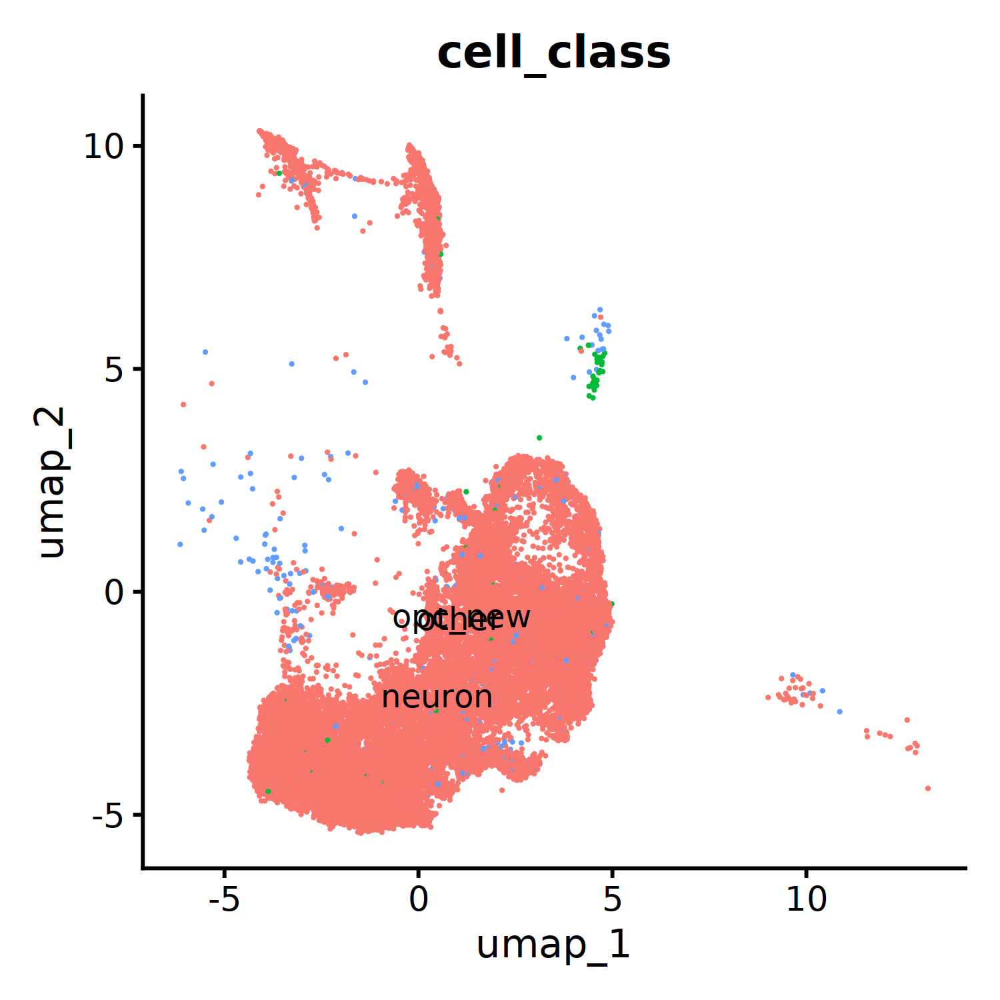

In [128]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% subset(subset = cell_class_cca == 'neuron') %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

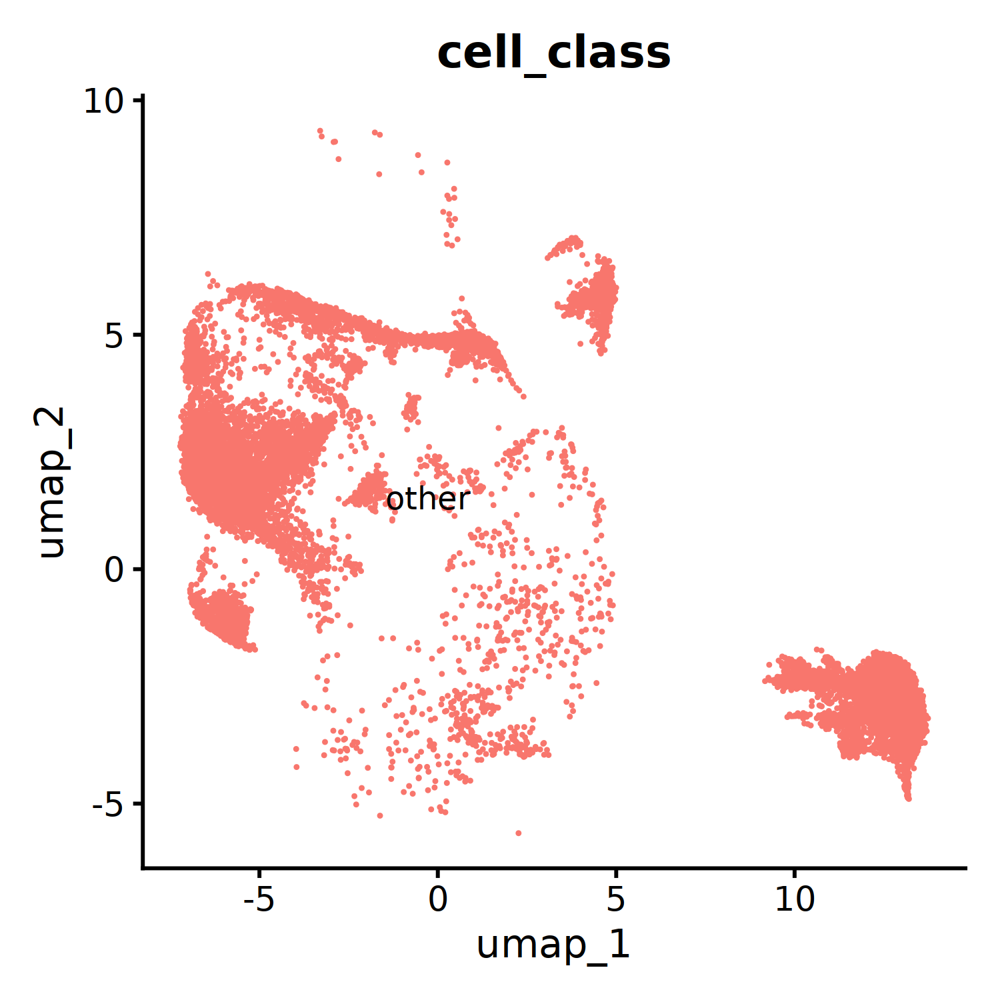

In [133]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% subset(subset = cell_class == 'other') %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

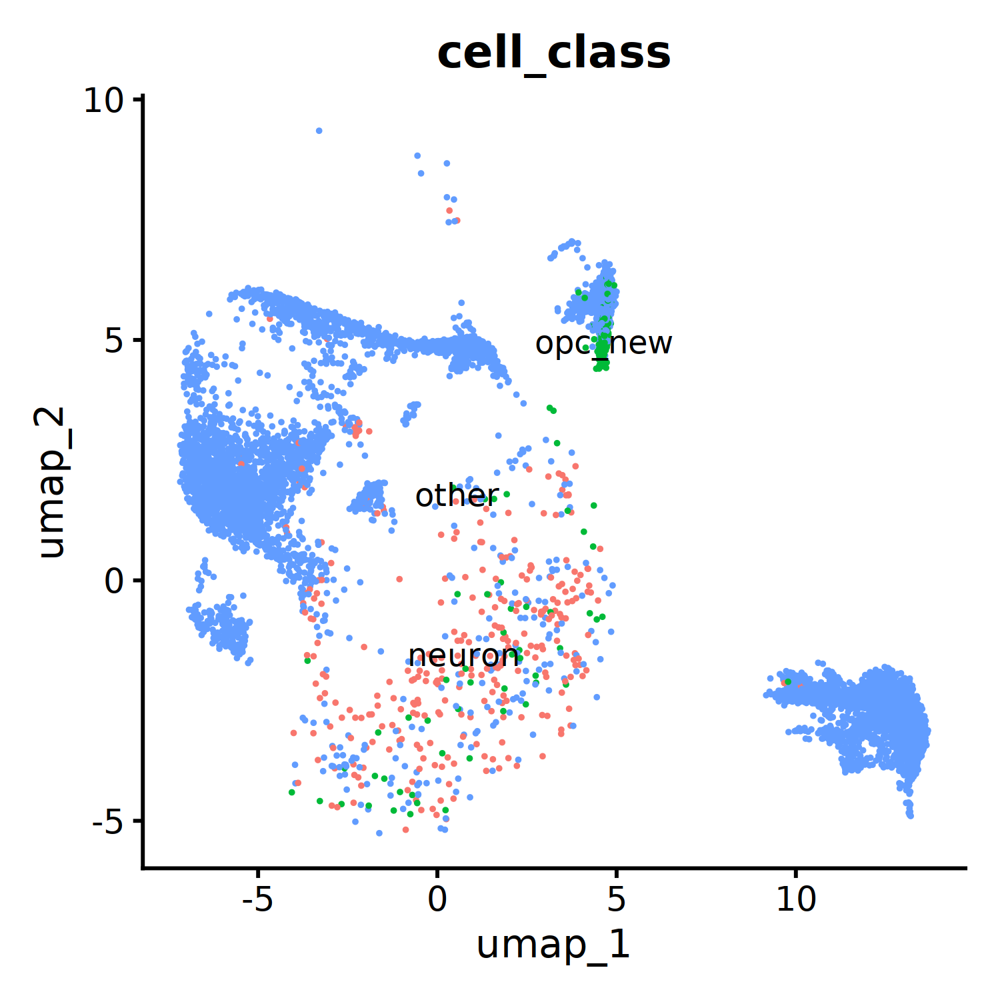

In [131]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% subset(subset = cell_class_cca == 'other') %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

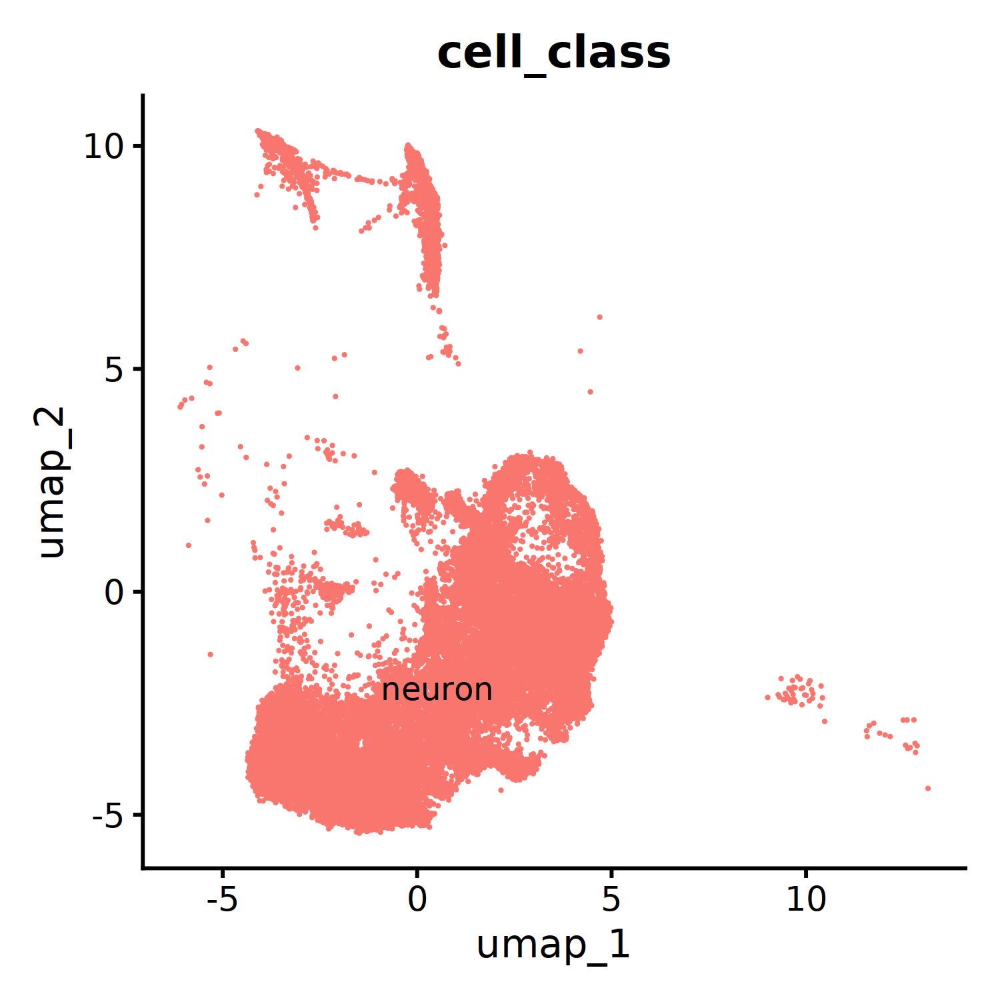

In [129]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% subset(subset = cell_class == 'neuron') %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

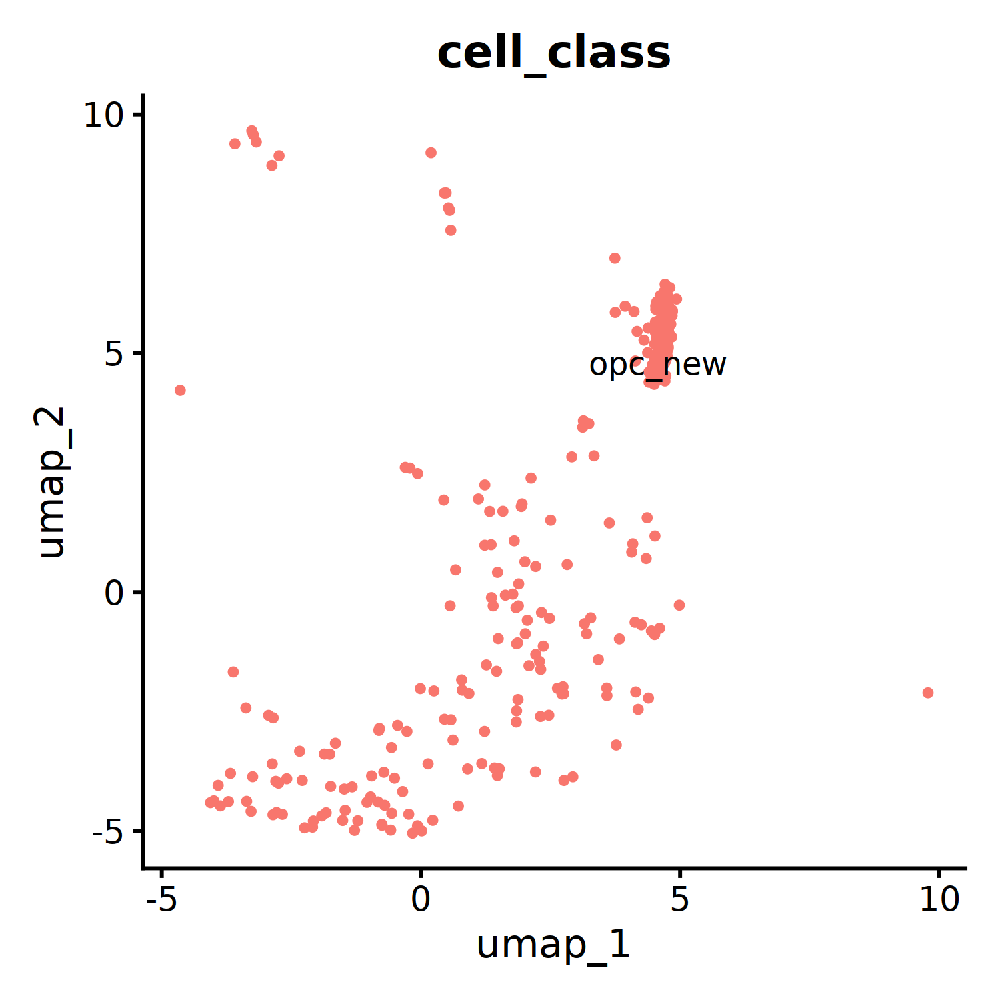

In [132]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% subset(subset = cell_class == 'opc_new') %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

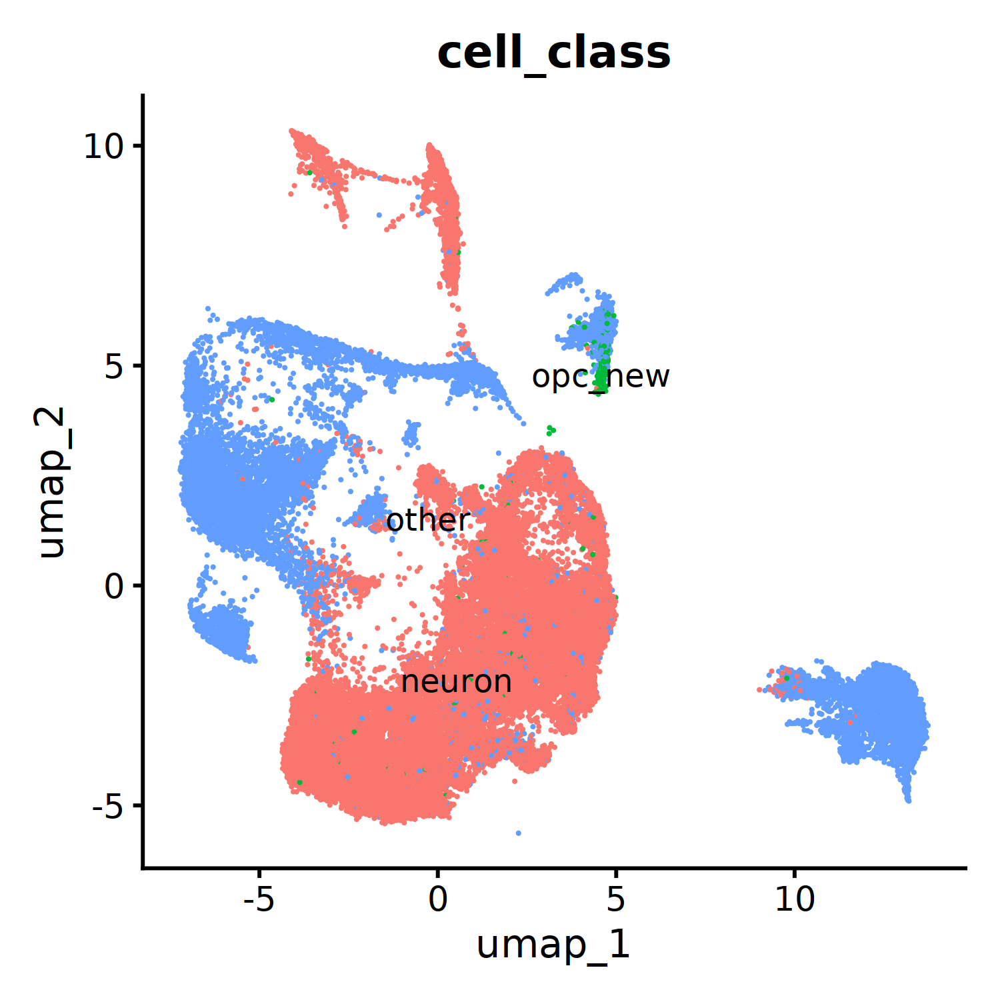

In [121]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj_2 %>% suppressWarnings, group.by = 'cell_class', label=TRUE) + NoLegend()

In [134]:
obj = obj_2

In [135]:
df = obj %>% 
suppressWarnings %>% `[[` %>% filter(!is.na(sample_name))

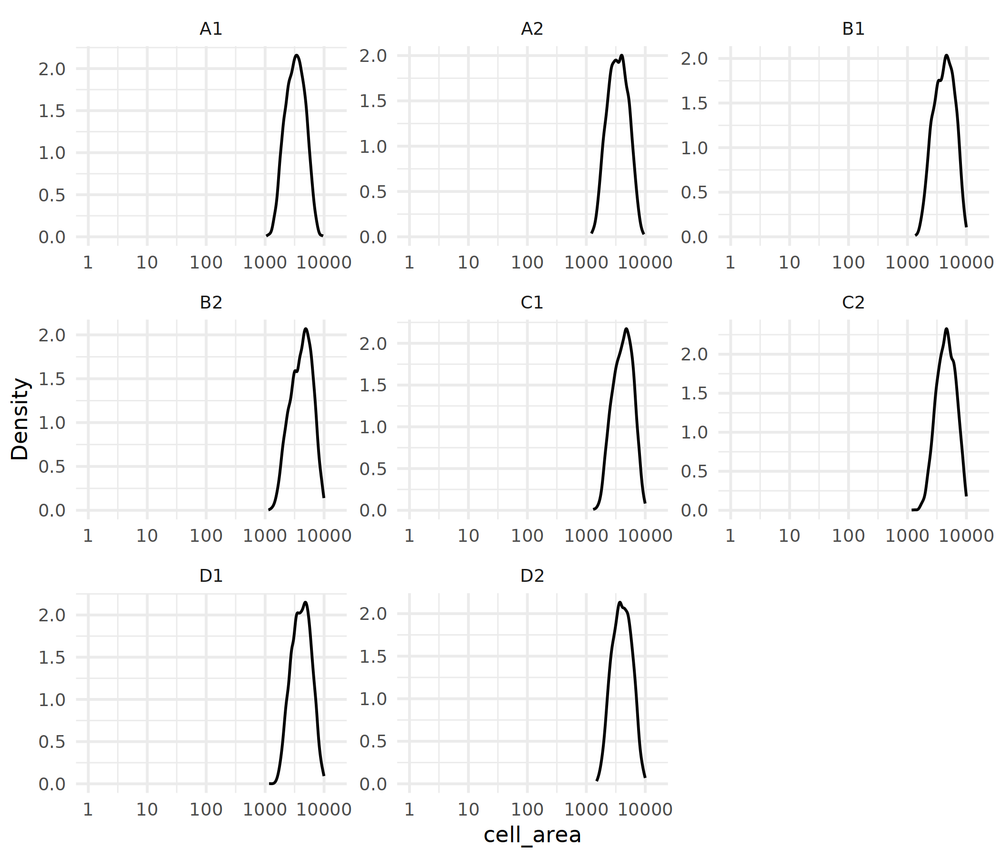

In [136]:
options(repr.plot.width=7, repr.plot.height=6)
ggplot(df, aes(x = cell_area)) +
  geom_density(alpha = 0.6) +  # Removed the fill mapping to nCount_Xenium
  facet_wrap(~ sample_name, scales = "free") +  # Changed to facet by sample_name
  scale_x_log10() +
  coord_cartesian(xlim = c(1, 15000)) +
  theme_minimal() +
  labs(x = "cell_area", y = "Density") +  # Corrected the x-axis label
  scale_fill_viridis_d() +  # Kept for color scale, adjust as needed
  theme(legend.position = "bottom")

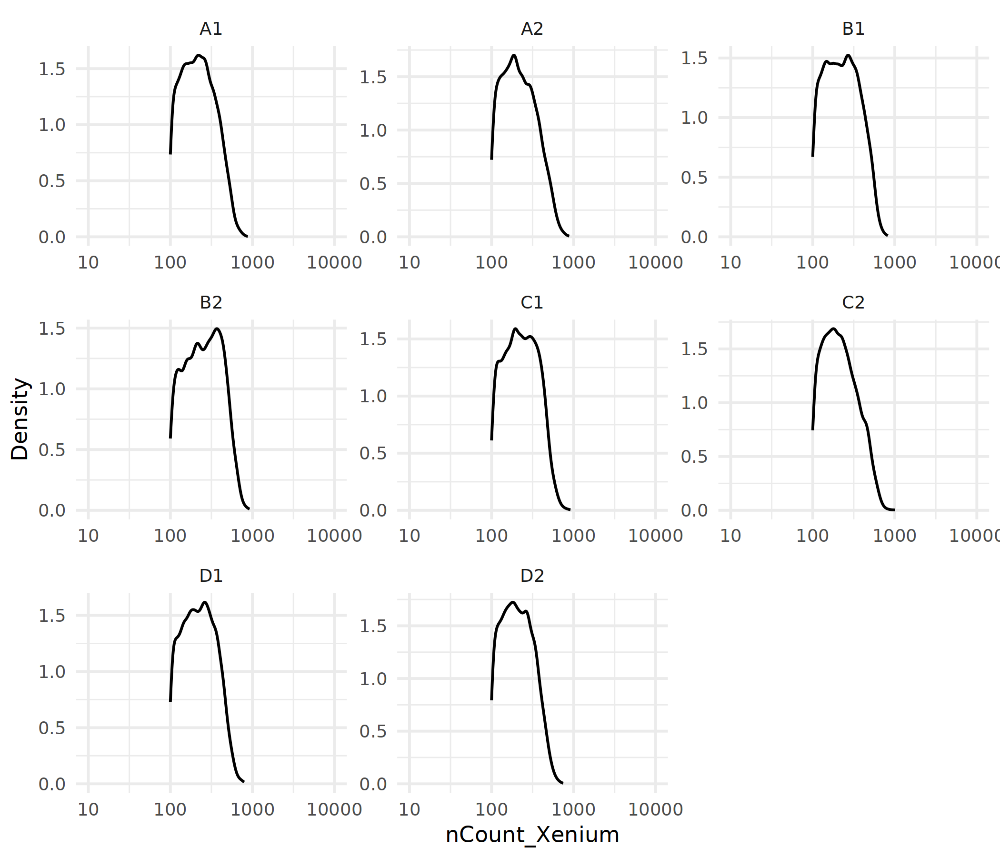

In [137]:
ggplot(df, aes(x = nCount_Xenium)) +
  geom_density(alpha = 0.6) +  # Removed the fill mapping to nCount_Xenium
  facet_wrap(~ sample_name, scales = "free") +  # Changed to facet by sample_name
  scale_x_log10() +
  coord_cartesian(xlim = c(10, 10000)) +
  theme_minimal() +
  labs(x = "nCount_Xenium", y = "Density") +  # Corrected the x-axis label
  scale_fill_viridis_d() +  # Kept for color scale, adjust as needed
  theme(legend.position = "bottom")

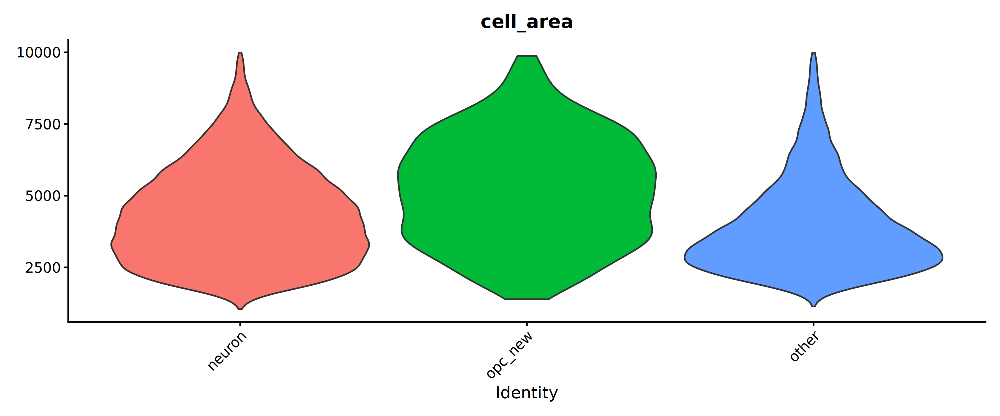

In [138]:
options(repr.plot.width=12, repr.plot.height=5, repr.plot.res=300) 
obj %>% VlnPlot(features = 'cell_area', group.by='cell_class', pt.size = 0) + NoLegend()

In [143]:
obj = obj %>% AddMetaData(obj %>%  `[[` %>% mutate(cell_class = first_type_cell_class)) %>%
                    reclass_by_gene_hilo_v02('Plp1', 20, 20, 'neuron', 'other') %>%
                    reclass_by_gene_hilo_v02('Pdgfra', 10, 10, 'neuron', 'opc_new') %>%                    
                    reclass_by_gene_hilo_v02('Agrp', 25, 25, 'other', 'neuron') %>%
                    reclass_by_gene_hilo_v02('Pomc', 25, 25, 'other', 'neuron')

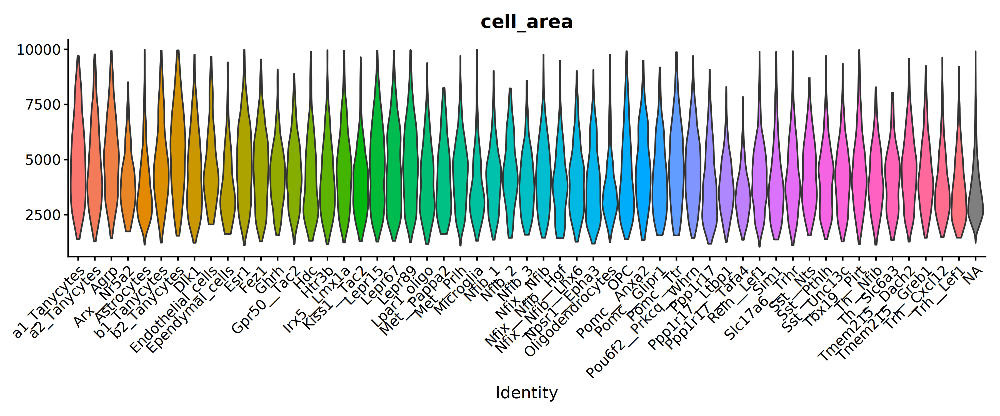

In [144]:
options(repr.plot.width=12, repr.plot.height=5, repr.plot.res=300) 
obj %>% VlnPlot(features = 'cell_area', group.by='labels', pt.size = 0) + NoLegend()

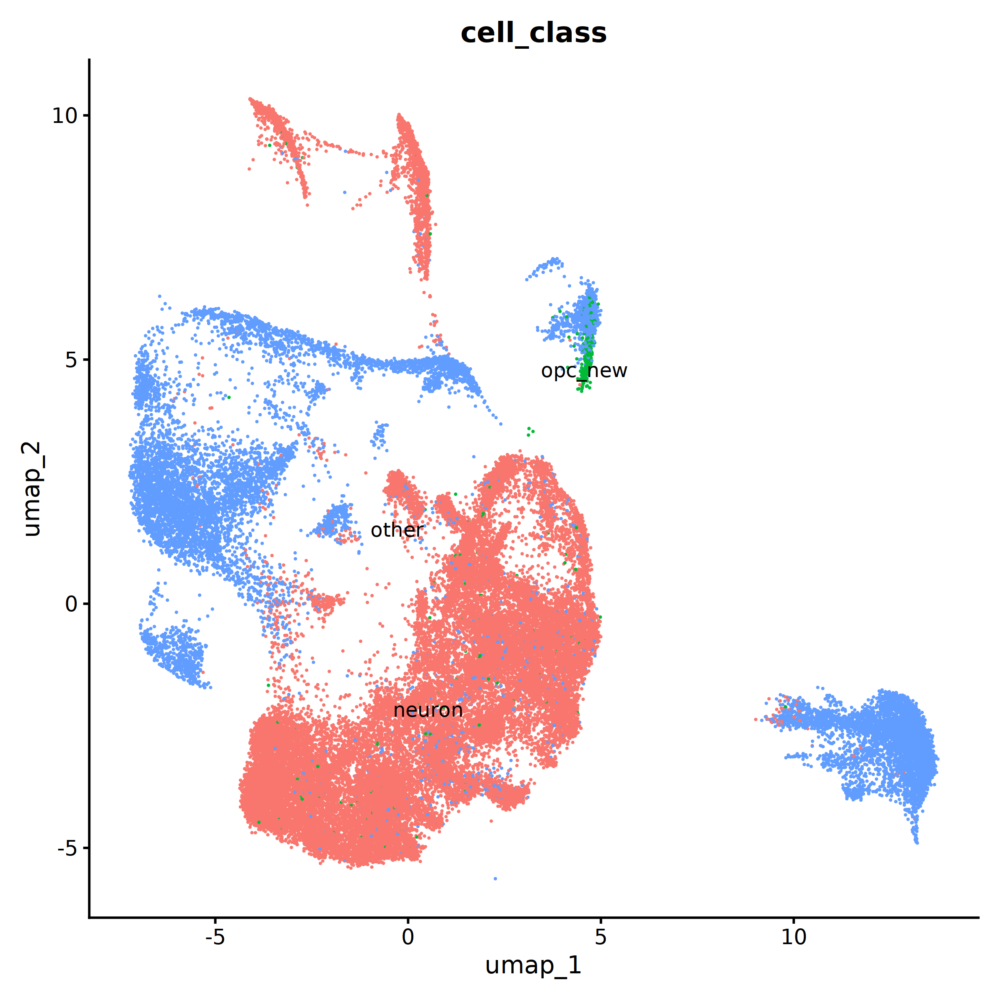

In [142]:
options(repr.plot.width=8, repr.plot.height=8, repr.plot.res=300)
DimPlot(obj, group.by = 'cell_class', label=TRUE) + NoLegend()

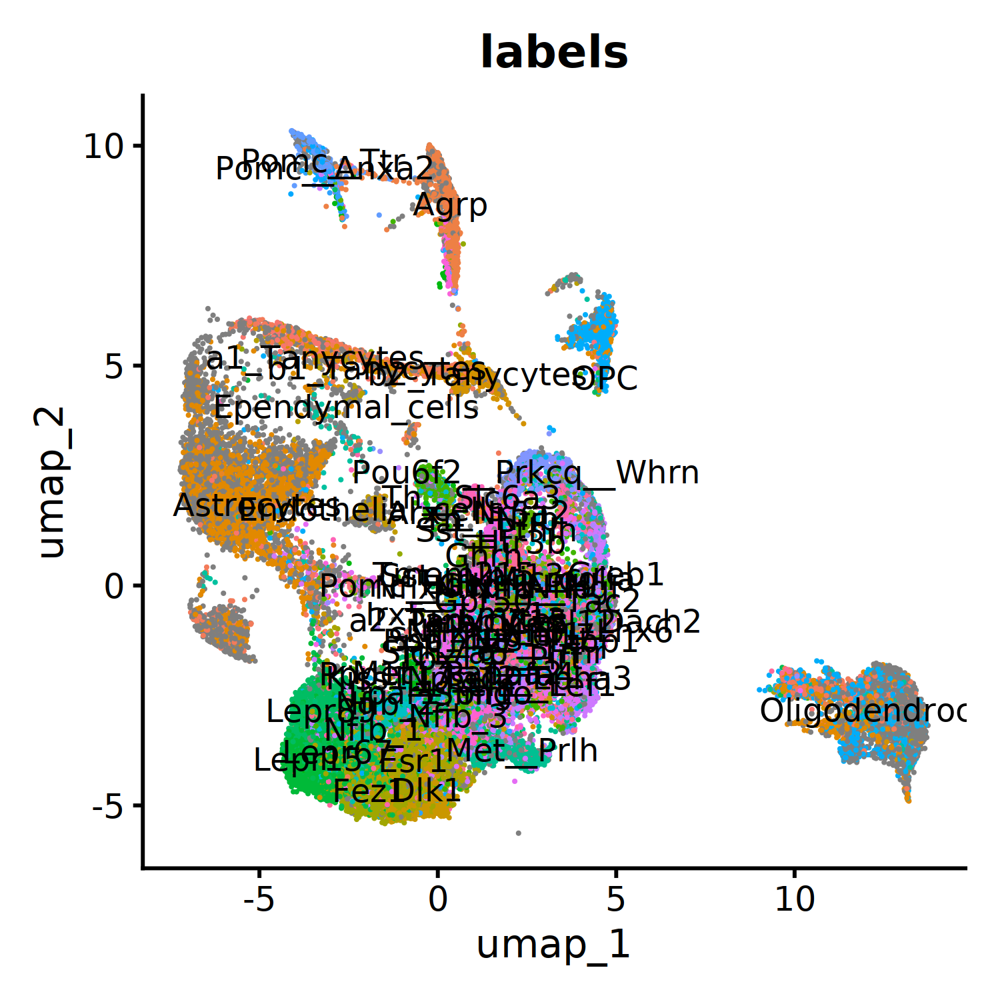

In [83]:
options(repr.plot.width=5, repr.plot.height=5, repr.plot.res=300)
DimPlot(obj, group.by = 'labels', label=TRUE) + NoLegend()

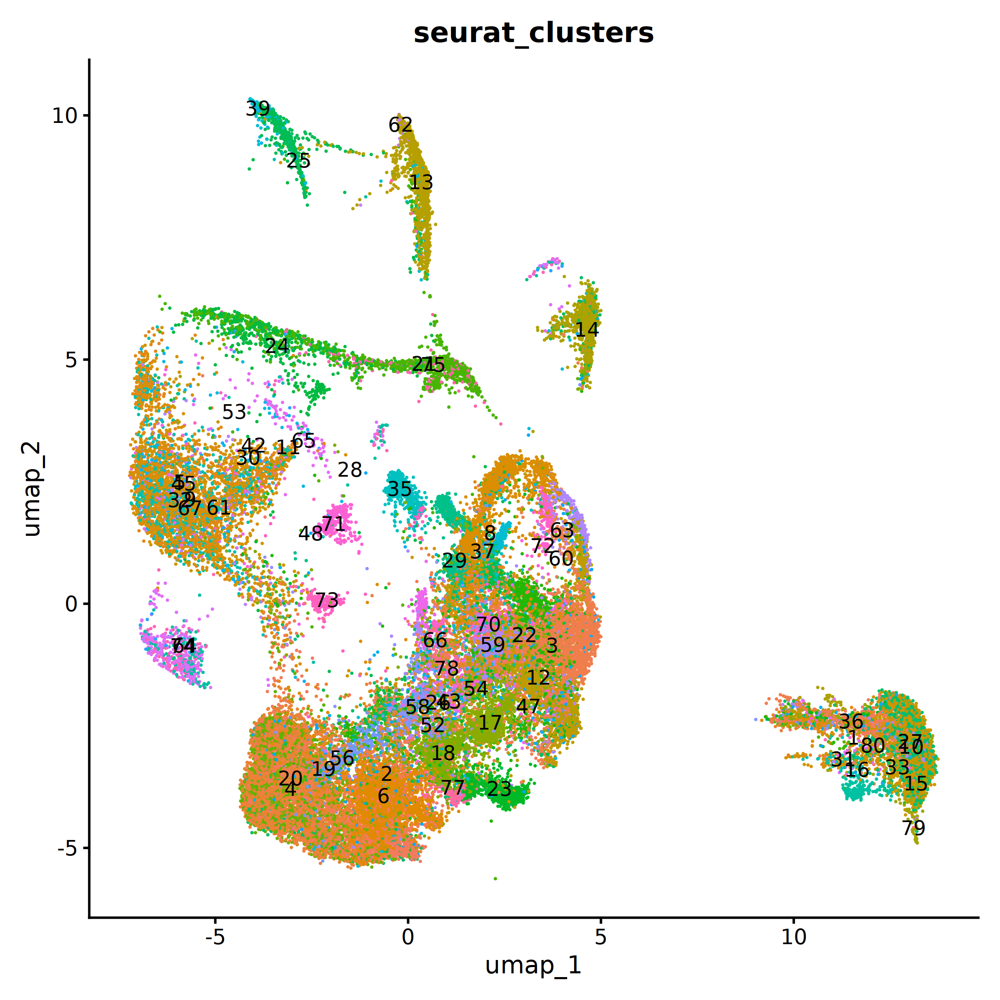

In [80]:
options(repr.plot.width=5, repr.plot.height=8, repr.plot.res=300)
DimPlot(obj, group.by = 'seurat_clusters', label=TRUE) + NoLegend()

In [82]:

markers_of_other = c("Pdgfra", "Aqp4", "Rax", "Slc1a2", "Slc7a11", "Plp1", "Cfap299", 
"Pdzrn3", "Lrmda", "Bmp4", "Gpc5", "Trpm3", "P3h2", "Slit2", 
"Rgs6", "Sox5", "Deptor", "Fat3", "Luzp2", "Ptprt")

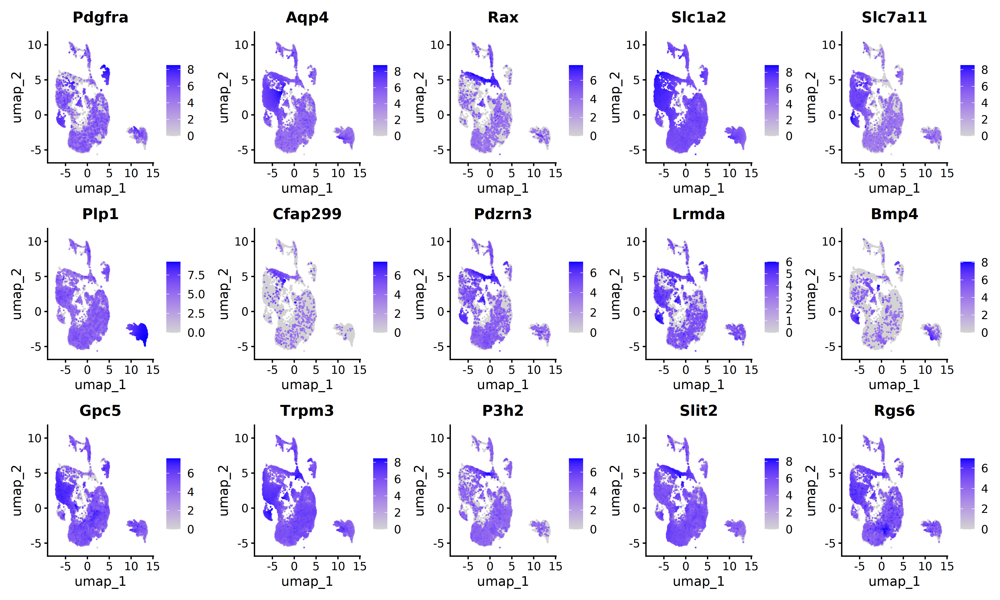

In [87]:
options(repr.plot.width=15, repr.plot.height=9, repr.plot.res=300)
FeaturePlot(obj %>% set_default_assay('Xenium'), ncol = 5, order = T,
            features = markers_of_other %>%  head(15))

Warning message:
“The `slot` argument of `VlnPlot()` is deprecated as of Seurat 5.0.0.
ℹ Please use the `layer` argument instead.”


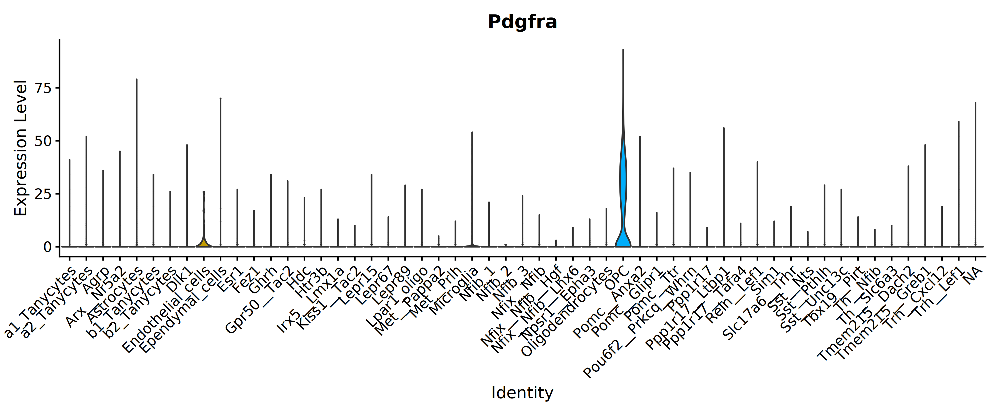

In [90]:
options(repr.plot.width=12, repr.plot.height=5, repr.plot.res=300) 
obj %>% VlnPlot(features = 'Pdgfra', group.by='labels', slot = 'counts', pt.size = 0) + NoLegend()

In [145]:
obj %>% `[[` %>% colnames

[1] "orig.ident"               "nCount_Xenium"           
 [3] "nFeature_Xenium"          "nCount_BlankCodeword"    
 [5] "nFeature_BlankCodeword"   "nCount_ControlCodeword"  
 [7] "nFeature_ControlCodeword" "nCount_ControlProbe"     
 [9] "nFeature_ControlProbe"    "cell_area"               
[11] "density"                  "elongation"              
[13] "avg_confidence"           "nucleus_area"            
[15] "sample_name"              "treatment"               
[17] "strain"                   "time"                    
[19] "seurat_clusters"          "spot_class_cell_class"   
[21] "first_type_cell_class"    "second_type_cell_class"  
[23] "first_class_cell_class"   "second_class_cell_class" 
[25] "min_score_cell_class"     "singlet_score_cell_class"
[27] "conv_all_cell_class"      "conv_doublet_cell_class" 
[29] "cell_class"               "cell_class_cca"          
[31] "polar_label"              "labels"

In [147]:
obj_neuron = obj %>%
subset(subset = first_type_cell_class == 'neuron') %>%
suppressWarnings

ref_neuron = qs::qread('_targets/objects/obj_d5_neuron_01')

annot_df_neuron = run_rctd(obj_neuron, ref_neuron, 'labels')

annot_df_neuron %>% head

Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"
[1] "gather_results: finished 5000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 39574

process_cell_type_info: number of genes in reference: 25652




               Agrp          Arx__Nr5a2                Dlk1                Esr1 
               1794                 158                 685                1069 
               Fez1                Ghrh         Gpr50__Tac2                 Hdc 
               1298                 848                 471                 319 
              Htr3b         Irx5__Lmx1a         Kiss1__Tac2              Lepr15 
               1600                1723                1180                2151 
             Lepr67              Lepr89         Lpar1_oligo         Met__Pappa2 
               1019                1698                 424                 348 
          Met__Prlh              Nfib_1              Nfib_2              Nfib_3 
               1192                 846                 148                 190 
         Nfix__Nfib     Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3 
                737                 204                 545                 803 
        Pomc__Anxa2        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Agrp found DE genes: 9

get_de_genes: Arx__Nr5a2 found DE genes: 10

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 10

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 5

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 5

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 5

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 6

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


,spot_class,first_type,second_type,first_class,second_class,min_score,singlet_score,conv_all,conv_doublet
,<fct>,<fct>,<fct>,<lgl>,<lgl>,<dbl>,<dbl>,<lgl>,<lgl>
Cell10000_9129_13312_1,reject,Agrp,Trh__Cxcl12,FALSE,FALSE,100.81483,140.8148,TRUE,TRUE
Cell10006_3751_1404_1,reject,Htr3b,Sst__Pthlh,FALSE,FALSE,120.72334,160.7233,TRUE,TRUE
Cell10008_4292_3239_1,reject,Pomc__Anxa2,Tbx19__Pirt,FALSE,FALSE,82.82212,122.8221,TRUE,TRUE
Cell10019_6171_751_1,reject,Pomc__Anxa2,Trh__Cxcl12,FALSE,FALSE,93.14142,133.1414,TRUE,TRUE
Cell1001_7582_755_1,reject,Met__Prlh,Pomc__Glipr1,FALSE,FALSE,82.32863,122.3286,TRUE,TRUE
Cell10021_10259_2827_1,reject,Met__Prlh,Pomc__Ttr,FALSE,FALSE,95.54212,135.5421,TRUE,TRUE


In [148]:
obj_other = obj %>%
subset(subset = first_type_cell_class == 'other') %>%
suppressWarnings

ref_other = qs::qread('_targets/objects/obj_d5_other_01')

annot_df_other = run_rctd(obj_other, ref_other, 'labels')

annot_df_other %>% head

Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 33

get_de_genes: total DE genes: 80

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 33

get_de_genes: total DE genes: 80

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 32

get_de_genes: total DE genes: 79

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 33

get_de_genes: total DE genes: 80

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 33

get_de_genes: total DE genes: 80

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 32

get_de_genes: total DE genes: 79

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 33

get_de_genes: total DE genes: 80

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 10614

process_cell_type_info: number of genes in reference: 20440




     a1_Tanycytes      a2_Tanycytes        Astrocytes      b1_Tanycytes 
              681              1808              4429               639 
     b2_Tanycytes Endothelial_cells   Ependymal_cells         Microglia 
              709                43               202               269 
 Oligodendrocytes               OPC 
              700              1134 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 10

get_de_genes: a2_Tanycytes found DE genes: 7

get_de_genes: Astrocytes found DE genes: 17

get_de_genes: b1_Tanycytes found DE genes: 11

get_de_genes: b2_Tanycytes found DE genes: 8

get_de_genes: Endothelial_cells found DE genes: 11

get_de_genes: Ependymal_cells found DE genes: 6

get_de_genes: Microglia found DE genes: 8

get_de_genes: Oligodendrocytes found DE genes: 21

get_de_genes: OPC found DE genes: 32

get_de_genes: total DE genes: 79

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: a1_Tanycytes found DE genes: 19

get_de_genes: a2_Tanycytes found DE genes: 17

get_de_genes: Astrocytes found DE genes: 20

get_de_genes: b1_Tanycytes found DE genes: 17

get_de_genes: b2_Tanycytes found DE genes: 13

get_de_genes: Endothelial_cells found DE genes: 12

get_de_genes: Ependymal_cells found D

[1] "gather_results: finished 1000"


,spot_class,first_type,second_type,first_class,second_class,min_score,singlet_score,conv_all,conv_doublet
,<fct>,<fct>,<fct>,<lgl>,<lgl>,<dbl>,<dbl>,<lgl>,<lgl>
Cell10003_8358_77_1,singlet,OPC,b2_Tanycytes,FALSE,FALSE,120.15040,137.86917,TRUE,TRUE
Cell10007_5614_2509_1,doublet_uncertain,OPC,b2_Tanycytes,FALSE,FALSE,116.49755,142.14254,TRUE,TRUE
Cell10010_8364_12318_1,doublet_uncertain,OPC,Astrocytes,FALSE,FALSE,149.43416,179.41623,TRUE,TRUE
Cell1002_1111_7230_1,singlet,Astrocytes,a1_Tanycytes,FALSE,FALSE,76.33761,78.98893,TRUE,TRUE
Cell10031_10672_10968_1,doublet_uncertain,Astrocytes,Endothelial_cells,FALSE,FALSE,100.13224,120.18826,TRUE,TRUE
Cell10061_7942_5796_1,singlet,Astrocytes,OPC,FALSE,FALSE,115.39082,127.85176,TRUE,TRUE


In [149]:
annot_df_neuron %>% group_by(spot_class) %>% summarise(n=n())

spot_class,n
<fct>,<int>
reject,18980
singlet,16380
doublet_certain,10
doublet_uncertain,184


In [150]:
annot_df_other %>% group_by(spot_class) %>% summarise(n=n())

spot_class,n
<fct>,<int>
reject,1230
singlet,9274
doublet_certain,725
doublet_uncertain,835


In [155]:
annot_df_neuron %>% group_by(spot_class, first_type) %>% summarise(n=n()) %>% filter(first_type == 'Agrp')

`summarise()` has grouped output by 'spot_class'. You can override using the
`.groups` argument.


spot_class,first_type,n
<fct>,<fct>,<int>
reject,Agrp,1834
singlet,Agrp,1241
doublet_certain,Agrp,5
doublet_uncertain,Agrp,117


In [156]:
annot_df_neuron %>% dim

[1] 35554     9

In [157]:
obj_neuron

An object of class Seurat 
400 features across 35558 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

In [158]:
obj_neuron = obj_neuron %>% process_xenium
obj_neuron

Normalizing layer: counts

Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
PC_ 1 
Positive:  Agrp, Ptprk, Pomc, Plp1, Aqp4, Htr3b, Hdac9, Erbb4, Il1rapl2, Kctd16 
	   Lef1, Bmp4, Nrxn3, Zfp804b, Pcdh9, Slc7a11, Rax, Tox, Cfap299, Rgs6 
	   Pdgfra, Lrmda, Pcdh11x, Kirrel3, Csmd1, Arhgap6, Fgf13, Slc1a2, Pcdh7, Immp2l 
Negative:  Tenm2, Slit2, Rbfox1, Brinp3, Kcnq3, Hs3st4, Grm7, Gria1, Lrp1b, Sgcz 
	   Grm8, Plcb1, Nrg3, Prkg1, Lingo2, Prr16, Car10, Cacna2d3, Pde4b, Cntn4 
	   Wwox, Ctnna2, Cntn5, Fam155a, Tenm3, Deptor, Kcnip4, Col25a1, Cadm2, Fat3 
PC_ 2 
Positive:  Nrxn3, Erbb4, Trpm3, Dlg2, Dcc, Lef1, Robo1, Kirrel3, Hdac9, Fgf13 
	   Kctd16, Rmst, Zfp804b, Ptprt, Gpc6, Gabrg3, Tenm3, Egfem1, Il1rapl2, Nrg1 
	   Mgat4c, Tox, Ptprd, Cadm2, Galntl6, Sorcs1, Fat3, Pde10a, Cacna2d3, Grid2 
Negative:  Hs3st4, Deptor, Kcnq3, Rbfox1, Gria1, Tenm2, 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35558
Number of edges: 1579906

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8756
Number of communities: 102
Elapsed time: 8 seconds


46 singletons identified. 56 final clusters.

UMAP will return its model

20:39:08 UMAP embedding parameters a = 0.9922 b = 1.112

20:39:08 Read 35558 rows and found 99 numeric columns

20:39:08 Using Annoy for neighbor search, n_neighbors = 30

20:39:08 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:39:14 Writing NN index file to temp file /scratch/nmq407/R_tmp//RtmpH1KKNX/file7c844a66742c

20:39:14 Searching Annoy index using 1 thread, search_k = 3000

20:39:37 Annoy recall = 100%

20:39:39 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

20:39:43 Initializing from normalized Laplacian + noise (using RSpectra)

20:39:45 Commencing optimization for 200 epochs, with 1691130 positive edges

20:40:30 Optimization finished



An object of class Seurat 
400 features across 35558 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

In [159]:
obj_neuron = obj_neuron %>% 
AddMetaData(annot_df_neuron %>% rename_with(~paste0(., "_neuron_labels")))

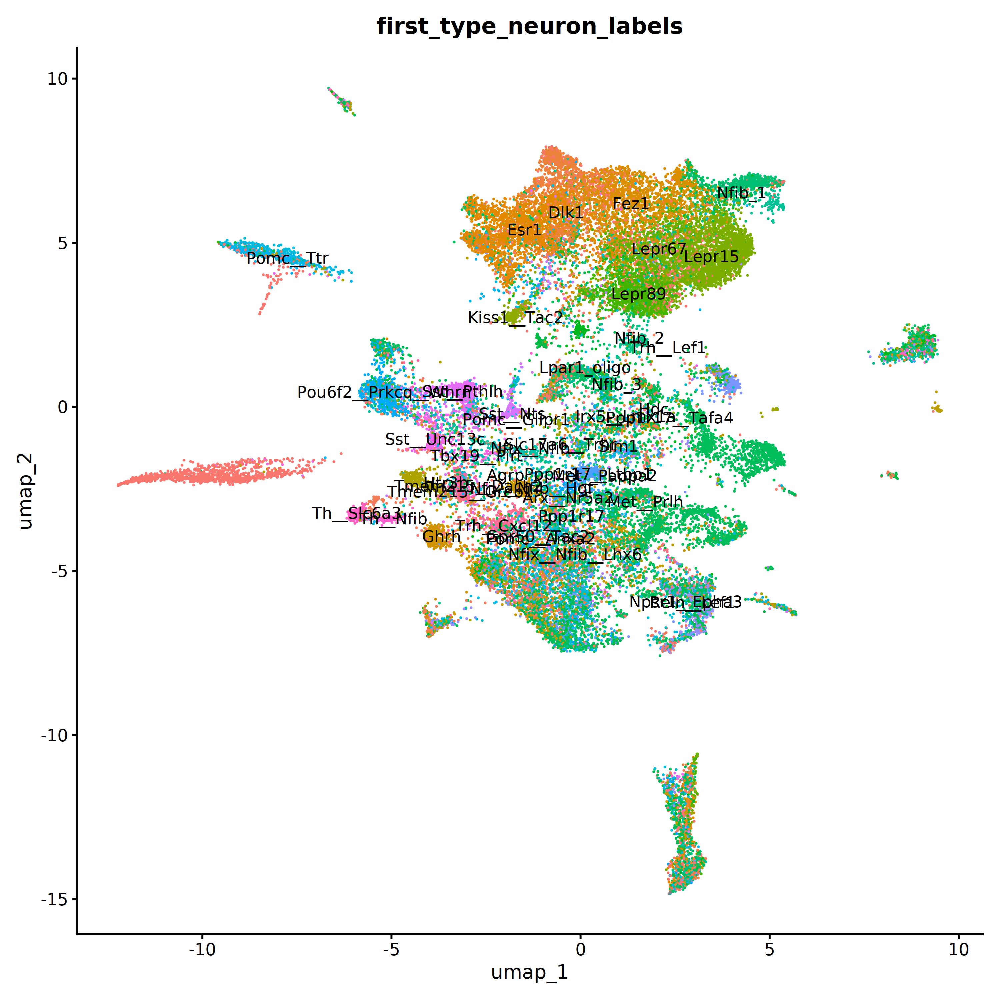

In [163]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron, group.by = 'first_type_neuron_labels', label=TRUE) + NoLegend()

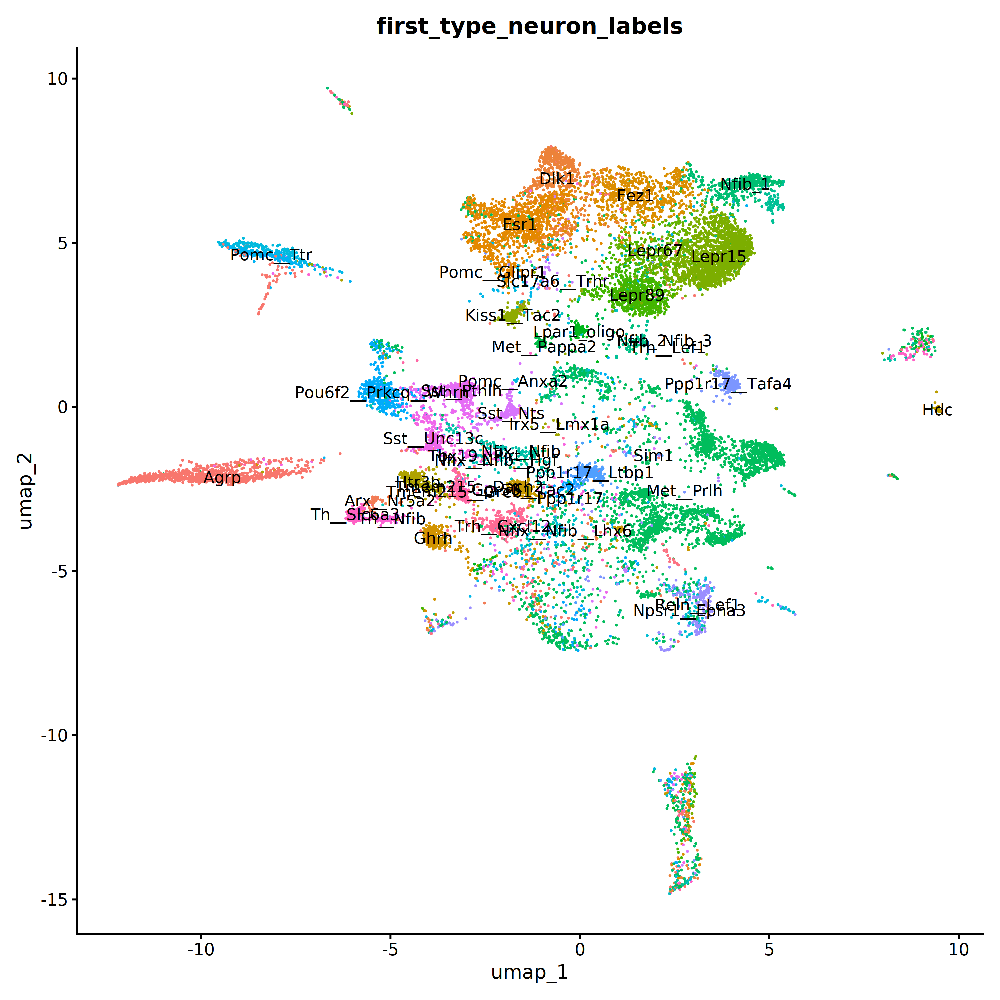

In [264]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron %>% 
        subset(subset = spot_class_neuron_labels != 'reject') %>% 
#         subset(subset = first_type_neuron_labels == 'Agrp') %>% 
        suppressWarnings, group.by = 'first_type_neuron_labels', label=T) + NoLegend() 

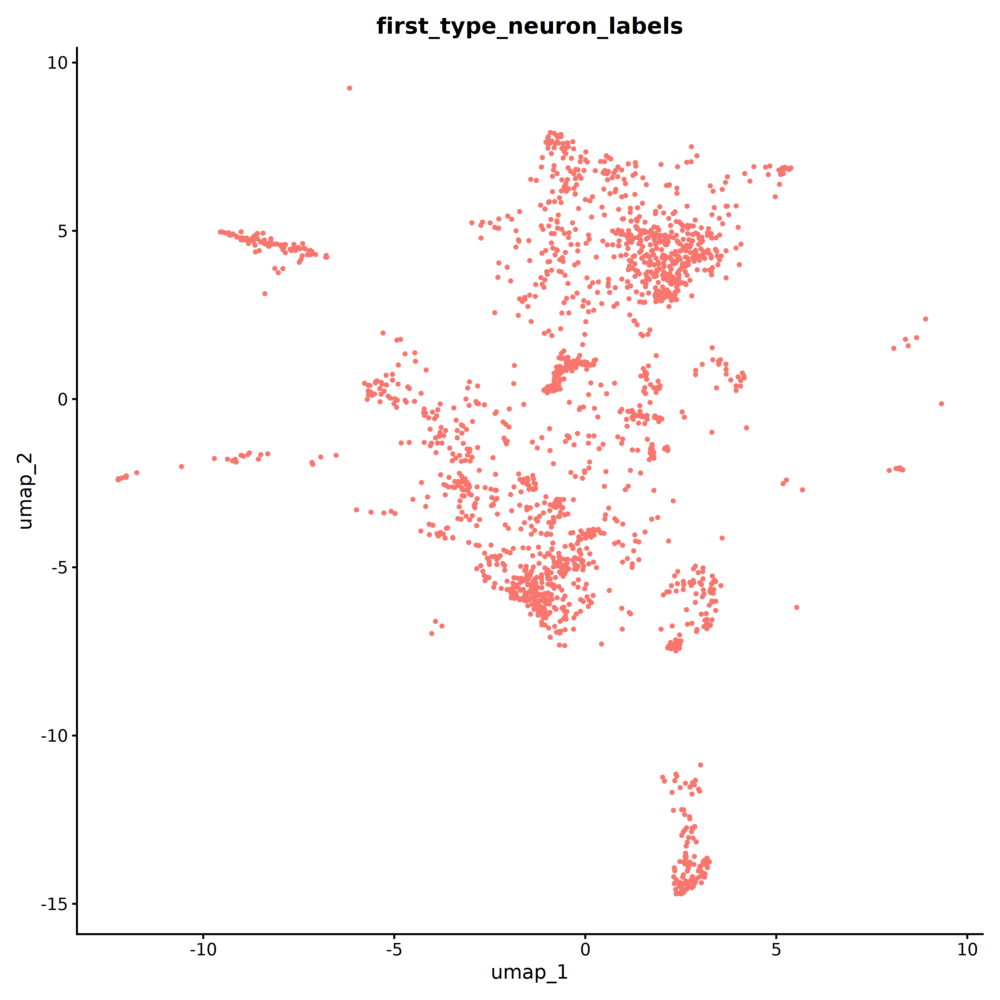

In [174]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron %>% 
        subset(subset = spot_class_neuron_labels == 'reject') %>% 
        subset(subset = first_type_neuron_labels == 'Agrp') %>% 
        suppressWarnings, group.by = 'first_type_neuron_labels', label=F) + NoLegend() 

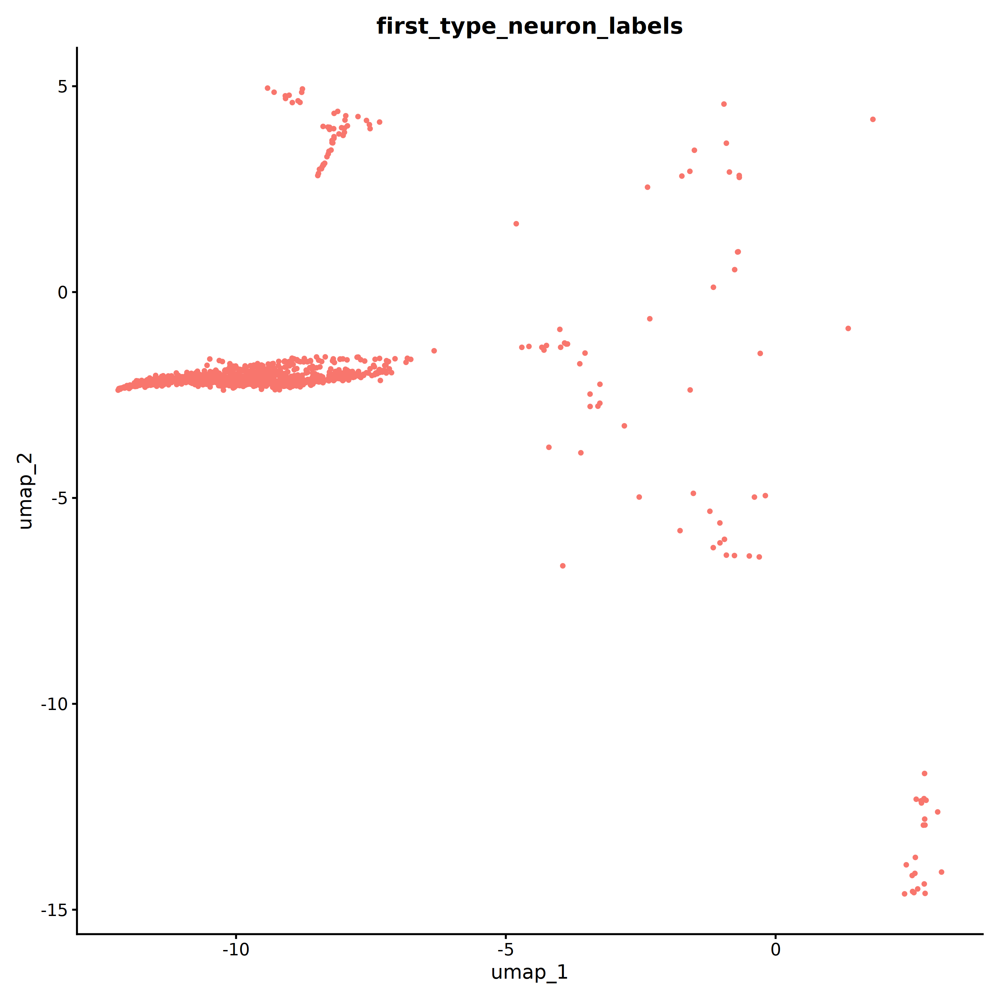

In [257]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron %>% 
        subset(subset = spot_class_neuron_labels == 'singlet') %>% 
        subset(subset = first_type_neuron_labels == 'Agrp') %>% 
        suppressWarnings, group.by = 'first_type_neuron_labels', label=F) + NoLegend() 

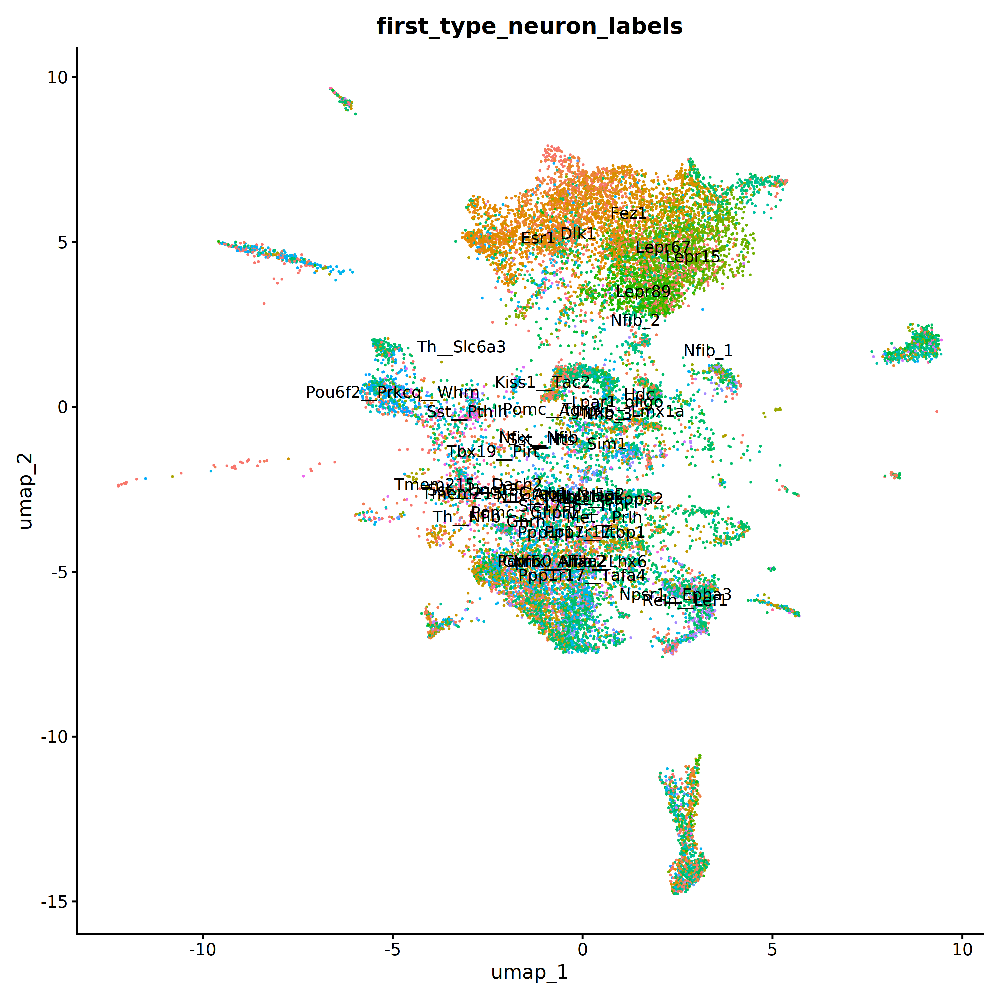

In [171]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron %>% subset(subset = spot_class_neuron_labels == 'reject') %>% suppressWarnings, group.by = 'first_type_neuron_labels', label=T) + NoLegend() 

In [185]:
obj_neuron %>% `[[` %>% 
group_by(first_type_neuron_labels, spot_class_neuron_labels) %>% 
mutate(n=n()) %>%
group_by(first_type_neuron_labels) %>%
mutate(n_labels = n()) %>%
mutate(frac_labels = n/n_labels) %>%
distinct(first_type_neuron_labels, spot_class_neuron_labels, .keep_all = TRUE) %>%
select(first_type_neuron_labels, spot_class_neuron_labels, n, n_labels, frac_labels) %>%
filter(spot_class_neuron_labels == 'reject') %>%
arrange(desc(frac_labels))

first_type_neuron_labels,spot_class_neuron_labels,n,n_labels,frac_labels
<fct>,<fct>,<int>,<int>,<dbl>
Irx5__Lmx1a,reject,221,242,0.913223140
Arx__Nr5a2,reject,924,1035,0.892753623
Met__Pappa2,reject,764,875,0.873142857
Hdc,reject,255,319,0.799373041
Pomc__Glipr1,reject,264,340,0.776470588
Nfix__Nfib__Lhx6,reject,190,246,0.772357724
Nfix__Nfib__Hgf,reject,188,252,0.746031746
Lpar1_oligo,reject,435,584,0.744863014
Pomc__Anxa2,reject,928,1256,0.738853503


In [263]:
obj_neuron %>% `[[` %>% 
group_by(first_type_neuron_labels, spot_class_neuron_labels) %>% 
mutate(n=n()) %>%
group_by(first_type_neuron_labels) %>%
mutate(n_labels = n()) %>%
mutate(frac_labels = n/n_labels) %>%
distinct(first_type_neuron_labels, spot_class_neuron_labels, .keep_all = TRUE) %>%
select(first_type_neuron_labels, spot_class_neuron_labels, n, n_labels, frac_labels) %>%
filter(spot_class_neuron_labels != 'reject') %>%
arrange(desc(frac_labels))

first_type_neuron_labels,spot_class_neuron_labels,n,n_labels,frac_labels
<fct>,<fct>,<int>,<int>,<dbl>
Trh__Cxcl12,singlet,306,307,0.9967427
Tmem215__Greb1,singlet,209,212,0.9858491
Trh__Lef1,singlet,40,41,0.9756098
Sst__Pthlh,singlet,414,461,0.8980477
Sst__Unc13c,singlet,291,334,0.8712575
Th__Nfib,singlet,111,134,0.8283582
Tbx19__Pirt,singlet,114,144,0.7916667
Th__Slc6a3,singlet,244,313,0.7795527
Sst__Nts,singlet,184,248,0.7419355


In [186]:
annot_df_neuron %>%
head %>% print

                       spot_class  first_type  second_type first_class
Cell10000_9129_13312_1     reject        Agrp  Trh__Cxcl12       FALSE
Cell10006_3751_1404_1      reject       Htr3b   Sst__Pthlh       FALSE
Cell10008_4292_3239_1      reject Pomc__Anxa2  Tbx19__Pirt       FALSE
Cell10019_6171_751_1       reject Pomc__Anxa2  Trh__Cxcl12       FALSE
Cell1001_7582_755_1        reject   Met__Prlh Pomc__Glipr1       FALSE
Cell10021_10259_2827_1     reject   Met__Prlh    Pomc__Ttr       FALSE
                       second_class min_score singlet_score conv_all
Cell10000_9129_13312_1        FALSE 100.81483      140.8148     TRUE
Cell10006_3751_1404_1         FALSE 120.72334      160.7233     TRUE
Cell10008_4292_3239_1         FALSE  82.82212      122.8221     TRUE
Cell10019_6171_751_1          FALSE  93.14142      133.1414     TRUE
Cell1001_7582_755_1           FALSE  82.32863      122.3286     TRUE
Cell10021_10259_2827_1        FALSE  95.54212      135.5421     TRUE
                    

In [187]:
library(ggplot2)

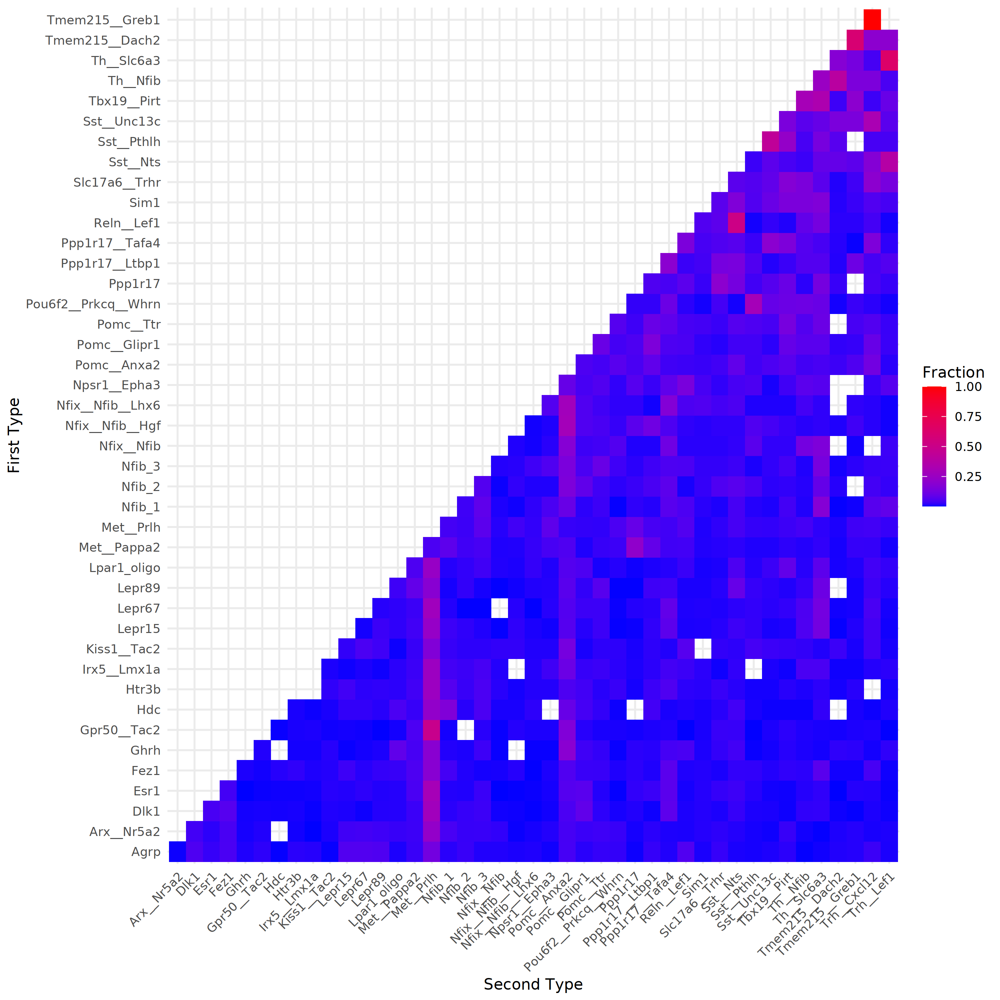

In [212]:
library(tidyverse)
library(ggplot2)

# Assuming annot_df_neuron is your data frame
# Calculate the fraction of each second_type within each first_type
fraction_df <- annot_df_neuron %>%
filter(spot_class == 'reject') %>%
  count(first_type, second_type) %>% # Count occurrences
  group_by(first_type) %>%
  mutate(fraction = n / sum(n)) %>% # Calculate fraction
  ungroup()

# Plotting the heatmap
heatmap_plot <- ggplot(fraction_df, aes(x = second_type, y = first_type, fill = fraction)) + 
  geom_tile() + # Creates the heatmap tiles
  scale_fill_gradient(low = "blue", high = "red") + # Color gradient for fractions
  theme_minimal() + 
  theme(axis.text.x = element_text(angle = 45, hjust = 1)) + # Improve readability
  labs(x = "Second Type", y = "First Type", fill = "Fraction") # Labeling

# Display the plot
print(heatmap_plot)


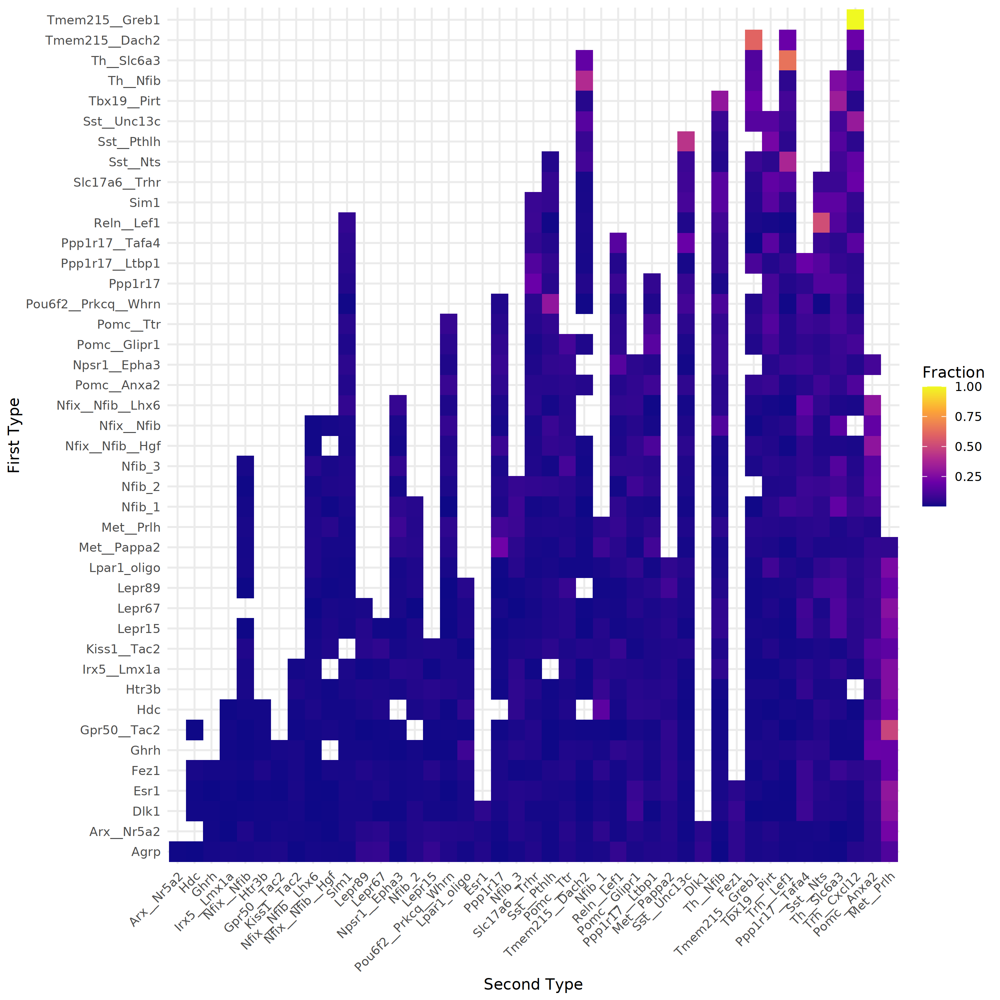

In [211]:
library(tidyverse)
library(ggplot2)
library(viridis) # for viridis scale

# Assuming annot_df_neuron is your data frame
# Calculate the fraction of each second_type within each first_type
fraction_df <- annot_df_neuron %>%
filter(spot_class == 'reject') %>%
  count(first_type, second_type) %>%
  group_by(first_type) %>%
  mutate(fraction = n / sum(n)) %>%
  ungroup()

# Order data for simulated clustering (here we're just ordering by sums, not true clustering)
fraction_df <- fraction_df %>%
  arrange(desc(fraction))

# Creating the heatmap
ggplot(fraction_df, aes(x = reorder(second_type, fraction), y = reorder(first_type, fraction), fill = fraction)) +
  geom_tile() +
  scale_fill_viridis_c(option = "C") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1)) +
  labs(x = "Second Type", y = "First Type", fill = "Fraction")


In [218]:
selected_cells = c(obj_neuron %>% `[[` %>% filter(first_type_neuron_labels != 'Agrp') %>% rownames,
                   obj_neuron %>% `[[` %>% filter(first_type_neuron_labels == 'Agrp', spot_class_neuron_labels == 'reject') %>% rownames)

In [248]:
create.RCTD

function (spatialRNA, reference, max_cores = 4, test_mode = FALSE, 
    gene_cutoff = 0.000125, fc_cutoff = 0.5, gene_cutoff_reg = 2e-04, 
    fc_cutoff_reg = 0.75, UMI_min = 100, UMI_max = 2e+07, counts_MIN = 10, 
    UMI_min_sigma = 300, class_df = NULL, CELL_MIN_INSTANCE = 25, 
    cell_type_names = NULL, MAX_MULTI_TYPES = 4, keep_reference = F, 
    cell_type_profiles = NULL, CONFIDENCE_THRESHOLD = 5, DOUBLET_THRESHOLD = 20) 
{
    config <- list(gene_cutoff = gene_cutoff, fc_cutoff = fc_cutoff, 
        gene_cutoff_reg = gene_cutoff_reg, fc_cutoff_reg = fc_cutoff_reg, 
        UMI_min = UMI_min, UMI_min_sigma = UMI_min_sigma, max_cores = max_cores, 
        N_epoch = 8, N_X = 50000, K_val = 100, N_fit = 1000, 
        N_epoch_bulk = 30, MIN_CHANGE_BULK = 1e-04, MIN_CHANGE_REG = 0.001, 
        UMI_max = UMI_max, counts_MIN = counts_MIN, MIN_OBS = 3, 
        MAX_MULTI_TYPES = MAX_MULTI_TYPES, CONFIDENCE_THRESHOLD = CONFIDENCE_THRESHOLD, 
        DOUBLET_THRESHOLD = DOUBLET_THRESHOLD)
    if (test_mode) 
        config <- list(gene_cutoff = 0.00125, fc_cutoff = 0.5, 
            gene_cutoff_reg = 0.002, fc_cutoff_reg = 0.75, UMI_min = 1000, 
            N_epoch = 1, N_X = 50000, K_val = 100, N_fit = 50, 
            N_epoch_bulk = 4, MIN_CHANGE_BULK = 1, MIN_CHANGE_REG = 0.001, 
            UMI_max = 2e+05, MIN_OBS = 3, max_cores = 1, counts_MIN = 5, 
            UMI_min_sigma = 300, MAX_MULTI_TYPES = MAX_MULTI_TYPES, 
            CONFIDENCE_THRESHOLD = CONFIDENCE_THRESHOLD, DOUBLET_THRESHOLD = DOUBLET_THRESHOLD)
    if (is.null(cell_type_profiles)) {
        if (is.null(cell_type_names)) 
            cell_type_names <- levels(reference@cell_types)
        cell_type_info <- list(info = process_cell_type_info(reference, 
            cell_type_names = cell_type_names, CELL_MIN = CELL_MIN_INSTANCE), 
            renorm = NULL)
    }
    else {
        cell_type_names <- colnames(cell_type_profiles)
        cell_type_info <- list(info = list(cell_type_profiles, 
            cell_type_names, length(cell_type_names)), renorm = NULL)
    }
    if (!keep_reference) 
        reference <- create_downsampled_data(reference, n_samples = 5)
    puck.original = restrict_counts(spatialRNA, rownames(spatialRNA@counts), 
        UMI_thresh = config$UMI_min, UMI_max = config$UMI_max, 
        counts_thresh = config$counts_MIN)
    message("create.RCTD: getting regression differentially expressed genes: ")
    gene_list_reg = get_de_genes(cell_type_info$info, puck.original, 
        fc_thresh = config$fc_cutoff_reg, expr_thresh = config$gene_cutoff_reg, 
        MIN_OBS = config$MIN_OBS)
    if (length(gene_list_reg) < 10) 
        stop("create.RCTD: Error: fewer than 10 regression differentially expressed genes found")
    message("create.RCTD: getting platform effect normalization differentially expressed genes: ")
    gene_list_bulk = get_de_genes(cell_type_info$info, puck.original, 
        fc_thresh = config$fc_cutoff, expr_thresh = config$gene_cutoff, 
        MIN_OBS = config$MIN_OBS)
    if (length(gene_list_bulk) < 10) 
        stop("create.RCTD: Error: fewer than 10 bulk differentially expressed genes found")
    puck = restrict_counts(puck.original, gene_list_bulk, UMI_thresh = config$UMI_min, 
        UMI_max = config$UMI_max, counts_thresh = config$counts_MIN)
    puck = restrict_puck(puck, colnames(puck@counts))
    if (is.null(class_df)) 
        class_df <- data.frame(cell_type_info$info[[2]], row.names = cell_type_info$info[[2]])
    colnames(class_df)[1] = "class"
    internal_vars <- list(gene_list_reg = gene_list_reg, gene_list_bulk = gene_list_bulk, 
        proportions = NULL, class_df = class_df, cell_types_assigned = F)
    new("RCTD", spatialRNA = puck, originalSpatialRNA = puck.original, 
        reference = reference, config = config, cell_type_info = cell_type_info, 
        internal_vars = internal_vars)
}
<bytecode: 0x55bfaad3e2a8>
<environment: namespace:spacexr>

In [246]:
obj_neuron_2 = obj_neuron %>%
    subset(cells = selected_cells) %>%
    suppressWarnings

ref_neuron = qs::qread('_targets/objects/obj_d5_neuron_01')

annot_df_neuron_2 = run_rctd(obj_neuron_2,
                           ref_neuron %>% subset(subset = labels != 'Agrp'), 'labels',
                            confidence_threshold=1,
                            doublet_threshold=20)

annot_df_neuron_2 %>% dim
annot_df_neuron_2 %>% head

Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"
[1] "gather_results: finished 5000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


Begin: process_cell_type_info

process_cell_type_info: number of cells in reference: 37780

process_cell_type_info: number of genes in reference: 25652




         Arx__Nr5a2                Dlk1                Esr1                Fez1 
                158                 685                1069                1298 
               Ghrh         Gpr50__Tac2                 Hdc               Htr3b 
                848                 471                 319                1600 
        Irx5__Lmx1a         Kiss1__Tac2              Lepr15              Lepr67 
               1723                1180                2151                1019 
             Lepr89         Lpar1_oligo         Met__Pappa2           Met__Prlh 
               1698                 424                 348                1192 
             Nfib_1              Nfib_2              Nfib_3          Nfix__Nfib 
                846                 148                 190                 737 
    Nfix__Nfib__Hgf    Nfix__Nfib__Lhx6        Npsr1__Epha3         Pomc__Anxa2 
                204                 545                 803                 289 
       Pomc__Glipr1        

End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: Arx__Nr5a2 found DE genes: 9

get_de_genes: Dlk1 found DE genes: 11

get_de_genes: Esr1 found DE genes: 10

get_de_genes: Fez1 found DE genes: 9

get_de_genes: Ghrh found DE genes: 4

get_de_genes: Gpr50__Tac2 found DE genes: 4

get_de_genes: Hdc found DE genes: 7

get_de_genes: Htr3b found DE genes: 4

get_de_genes: Irx5__Lmx1a found DE genes: 7

get_de_genes: Kiss1__Tac2 found DE genes: 8

get_de_genes: Lepr15 found DE genes: 7

get_de_genes: Lepr67 found DE genes: 7

get_de_genes: Lepr89 found DE genes: 3

get_de_genes: Lpar1_oligo found DE genes: 9

get_de_genes: Met__Pappa2 found DE genes: 9

get_de_genes: Met__Prlh found DE genes: 11

get_de_genes: Nfib_1 found DE genes: 8

get_de_genes: Nfib_2 found DE genes: 5

get_de_genes: Nfib_3 found DE genes: 7

get_de_genes: Nfix__Nfib found DE genes: 5

get_de_genes: Nfix__Nfib__Hgf found DE genes: 6

get_de_genes: Nfix__Nfib__Lhx

[1] "gather_results: finished 1000"
[1] "gather_results: finished 2000"
[1] "gather_results: finished 3000"
[1] "gather_results: finished 4000"


[1] 34191     9

,spot_class,first_type,second_type,first_class,second_class,min_score,singlet_score,conv_all,conv_doublet
,<fct>,<fct>,<fct>,<lgl>,<lgl>,<dbl>,<dbl>,<lgl>,<lgl>
Cell10000_9129_13312_1,singlet,Met__Prlh,Tmem215__Greb1,FALSE,FALSE,98.17710,102.23224,TRUE,TRUE
Cell10006_3751_1404_1,singlet,Sst__Pthlh,Htr3b,FALSE,FALSE,119.32418,126.62610,TRUE,TRUE
Cell10008_4292_3239_1,singlet,Pomc__Anxa2,Tbx19__Pirt,FALSE,FALSE,82.83240,86.52395,TRUE,TRUE
Cell10019_6171_751_1,singlet,Pomc__Anxa2,Trh__Cxcl12,FALSE,FALSE,91.54994,97.50895,TRUE,TRUE
Cell1001_7582_755_1,singlet,Pomc__Glipr1,Met__Prlh,FALSE,FALSE,81.38883,84.37248,TRUE,TRUE
Cell10021_10259_2827_1,singlet,Met__Prlh,Pomc__Ttr,FALSE,FALSE,93.15821,96.37576,TRUE,TRUE


In [247]:
annot_df_neuron_2 %>% group_by(spot_class) %>% summarise(n=n())

spot_class,n
<fct>,<int>
reject,3938
singlet,29824
doublet_certain,66
doublet_uncertain,363


In [252]:
obj_neuron_2 = obj_neuron_2 %>% 
AddMetaData(annot_df_neuron_2 %>% rename_with(~paste0(., "_neuron_2_labels")))

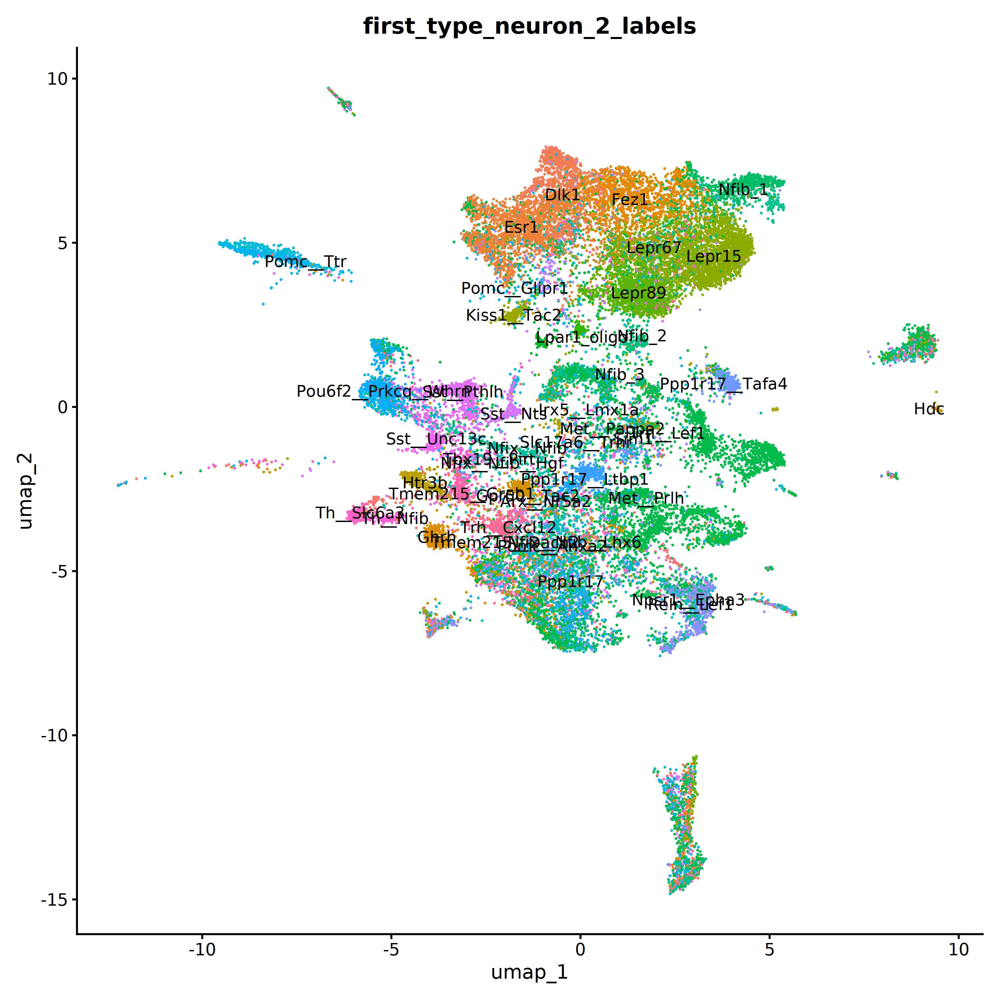

In [254]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron_2 %>% subset(subset = spot_class_neuron_2_labels != 'reject') %>% suppressWarnings, group.by = 'first_type_neuron_2_labels', label=T) + NoLegend() 

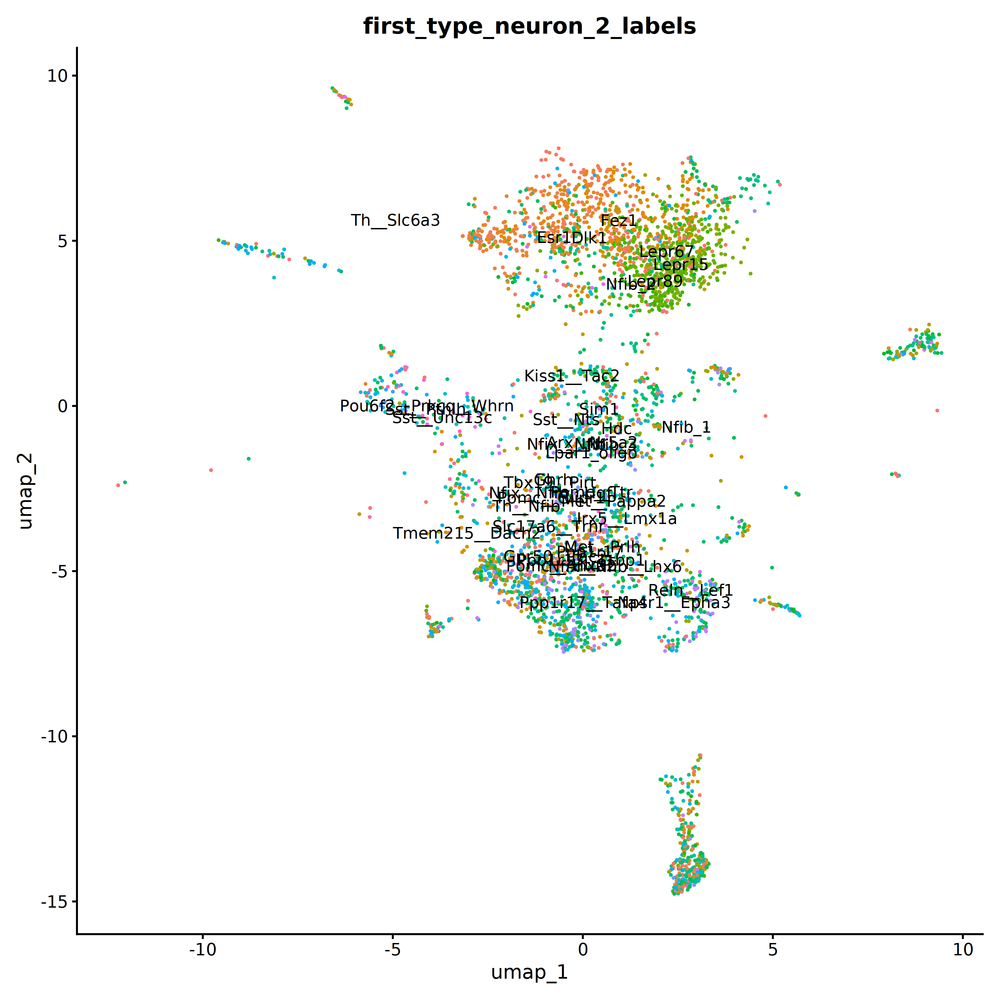

In [253]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(obj_neuron_2 %>% subset(subset = spot_class_neuron_2_labels == 'reject') %>% suppressWarnings, group.by = 'first_type_neuron_2_labels', label=T) + NoLegend() 

In [244]:
2

[1] 2

In [245]:
2

[1] 2

In [177]:
xe_obj_cca_td_2s %>% `[[` %>% group_by(labels) %>% summarise(n=n())

labels,n
<chr>,<int>
Agrp,1061
Arx__Nr5a2,103
Astrocytes,2876
Dlk1,1162
Endothelial_cells,113
Ependymal_cells,61
Esr1,2198
Fez1,1491
Ghrh,482


In [213]:
xe_obj_cca_td_2s 

An object of class Seurat 
400 features across 38520 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: scale.data, data, counts
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 15 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8 fov.2.2 fov.3.2 fov.4.2 fov.5.2 fov.6.2 fov.7.2 fov.8.2

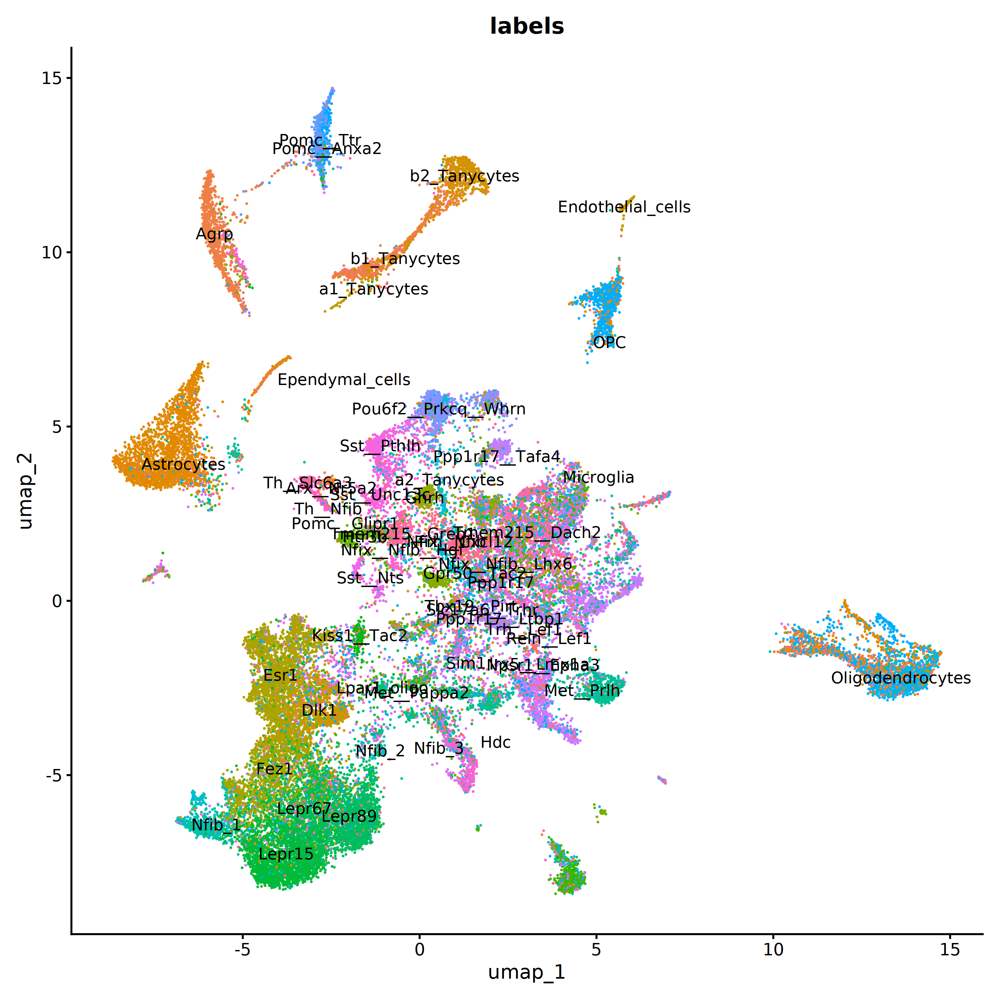

In [258]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(xe_obj_cca_td_2s, group.by = 'labels', label=T) + NoLegend() 

In [259]:
xe_obj_cca_td_neuron_2s = qs::qread('_targets/objects/xe_obj_cca_td_neuron_2s')
xe_obj_cca_td_neuron_2s

An object of class Seurat 
400 features across 31047 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

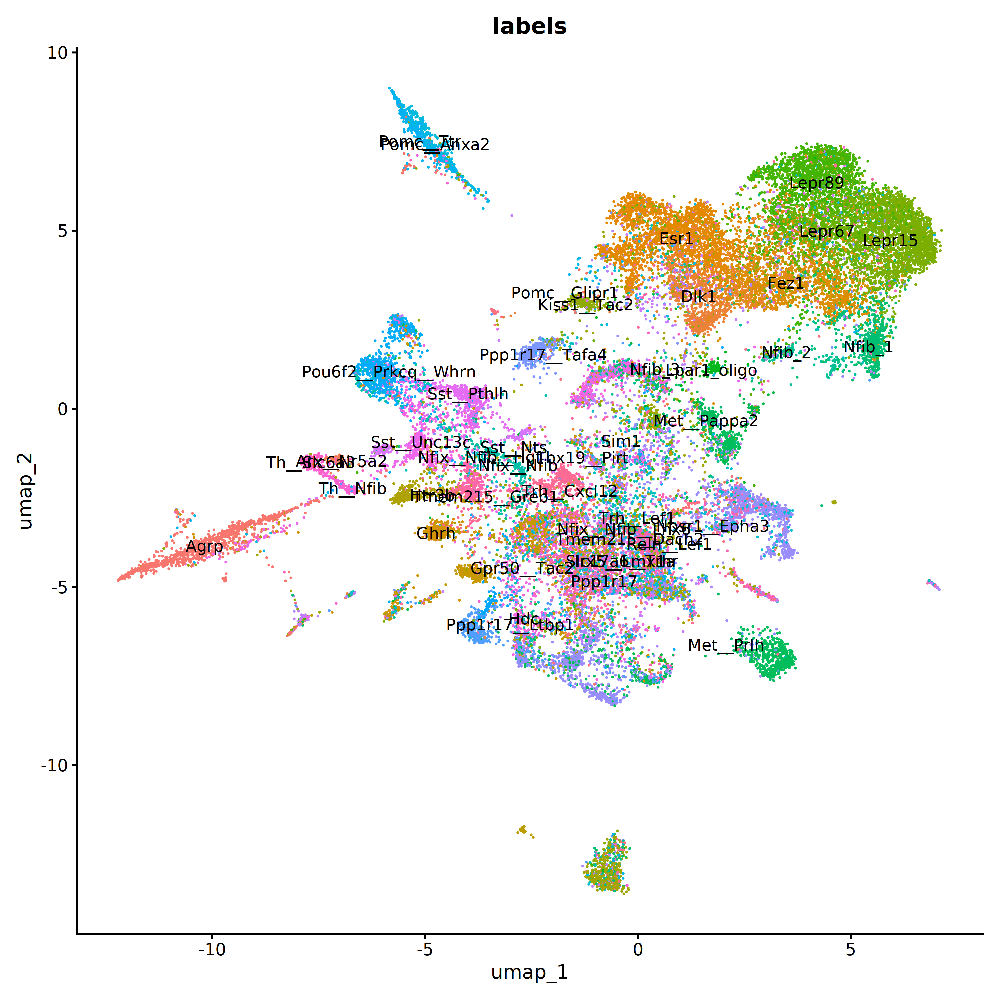

In [262]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(xe_obj_cca_td_neuron_2s, group.by = 'labels', label=T) + NoLegend() 

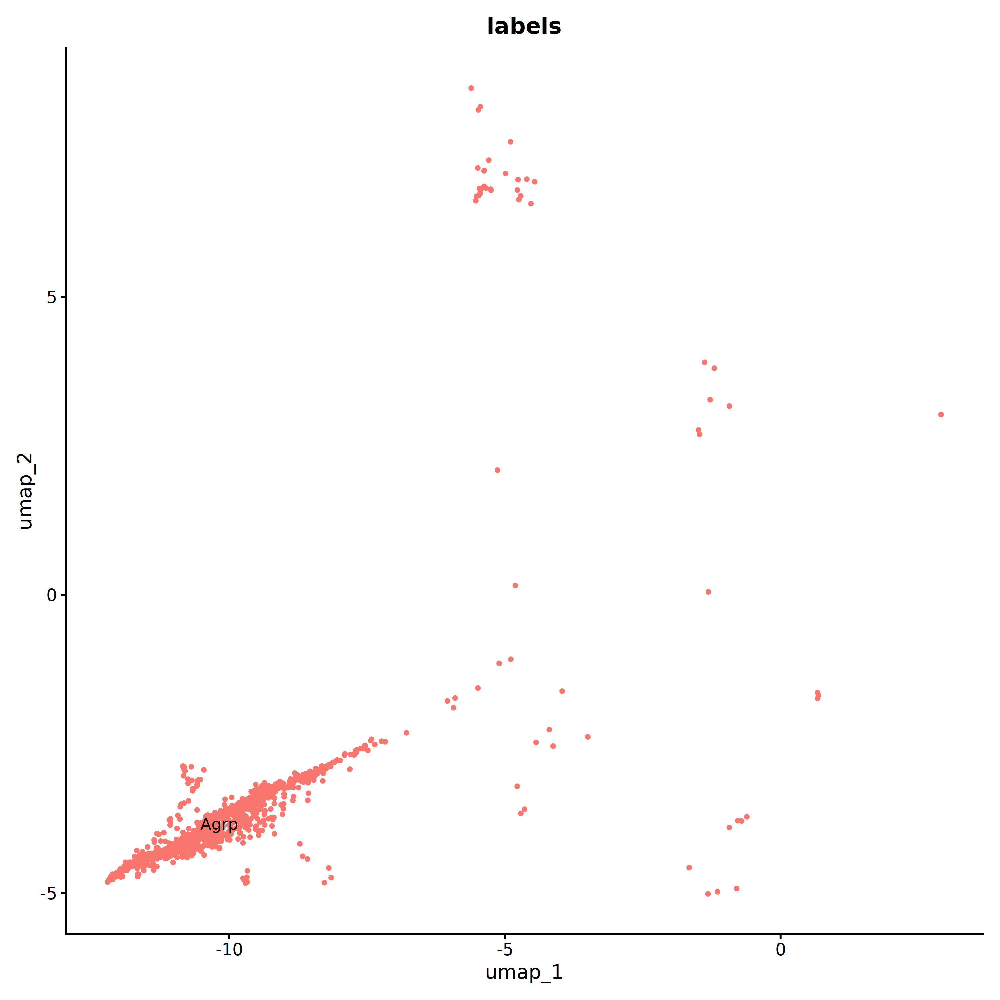

In [261]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res=300)
DimPlot(xe_obj_cca_td_neuron_2s %>% subset(subset = labels == 'Agrp') %>% suppressWarnings, group.by = 'labels', label=T) + NoLegend() 

In [266]:
rctd_name = 'rctd_blah'

xe_obj_cca_td_neuron_2s@misc[[rctd_name]] = c(1,2,3)

In [267]:
xe_obj_cca_td_neuron_2s@misc$rctd_blah

[1] 1 2 3

In [269]:
xe_obj_cca_td_neuron_2s@misc[['rctd_blah']]

[1] 1 2 3

In [312]:
annot_df_labels_neuron = qs::qread('_targets/objects/annot_df_labels_neuron_non_Agrp_1_5')
annot_df_labels_neuron

,spot_class,first_type,second_type,first_class,second_class,min_score,singlet_score,conv_all,conv_doublet
,<fct>,<fct>,<fct>,<lgl>,<lgl>,<dbl>,<dbl>,<lgl>,<lgl>
Cell10000_9129_13312_1,doublet_uncertain,Agrp,Trh__Cxcl12,FALSE,FALSE,99.91237,122.27175,TRUE,TRUE
Cell10006_3751_1404_1,doublet_uncertain,Sst__Pthlh,Htr3b,FALSE,FALSE,122.35490,129.81180,TRUE,TRUE
Cell10008_4292_3239_1,singlet,Pomc__Anxa2,Tbx19__Pirt,FALSE,FALSE,83.97156,87.55813,TRUE,TRUE
Cell10019_6171_751_1,doublet_certain,Pomc__Anxa2,Trh__Cxcl12,FALSE,FALSE,93.44791,99.20987,TRUE,TRUE
Cell10021_10259_2827_1,reject,Met__Prlh,Nfib_3,FALSE,FALSE,98.12803,108.12803,TRUE,TRUE
Cell10027_7136_4916_1,doublet_certain,Reln__Lef1,Agrp,FALSE,FALSE,119.54499,126.47645,TRUE,TRUE
Cell10030_8427_7219_1,reject,Agrp,Ppp1r17__Ltbp1,FALSE,FALSE,99.25896,109.25896,TRUE,TRUE
Cell10034_6518_408_1,singlet,Nfix__Nfib__Lhx6,Nfib_1,FALSE,FALSE,89.15295,89.92608,TRUE,TRUE
Cell10038_9994_13458_1,doublet_uncertain,Met__Prlh,Npsr1__Epha3,FALSE,FALSE,115.03574,122.78179,TRUE,TRUE


In [313]:
annot_df_labels_neuron %>% group_by(spot_class) %>% summarise(n=n())

spot_class,n
<fct>,<int>
reject,3659
singlet,16559
doublet_certain,7538
doublet_uncertain,5045


In [343]:
xe_obj = qs::qread('_targets/objects/obj_other_02')
obj_fgf1 = qs::qread('_targets/objects/obj_d5_other')
selected_label = 'OPC'


source("../00_preprocessing/splitwrapper.R")
source(paste0("../00_preprocessing/preprocessing.R"))
source(paste0("../01_milo/milo.R"))
source(paste0("../01_milo/milo_plotting.R"))
source(paste0("../00_cellbender/cellbender_preprocess.R"))
source("../00_cellbender/process_seurat.R")
source('../01_milo_cellbender/milo_cellbender.R')
source("../code/resolve2xe/LoadResolveBaysor.R")
source("../01_resolve/resolve.R")
source("resolve_cellbender.R")

      xe_obj = xe_obj %>%
        split_cell_labels(selected_label)
      obj_fgf1 = obj_fgf1 %>%
        split_cell_labels(selected_label)
      annot_df = run_rctd(xe_obj, obj_fgf1, 'polar_label', confidence_threshold = 5, doublet_threshold=20)
      annot_df

Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating


 OPC.neg OPC.none  OPC.pos 
     382      400      352 


End: process_cell_type_info

create.RCTD: getting regression differentially expressed genes: 

get_de_genes: OPC.neg found DE genes: 4

get_de_genes: OPC.none found DE genes: 1

get_de_genes: OPC.pos found DE genes: 8

get_de_genes: total DE genes: 13

create.RCTD: getting platform effect normalization differentially expressed genes: 

get_de_genes: OPC.neg found DE genes: 26

get_de_genes: OPC.none found DE genes: 22

get_de_genes: OPC.pos found DE genes: 9

get_de_genes: total DE genes: 45

fitBulk: decomposing bulk

chooseSigma: using initial Q_mat with sigma =  1

Likelihood value: 3312.74061678844



In [333]:
obj_fgf1 %>%
        split_cell_labels(selected_label) 

Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating

An object of class Seurat 
400 features across 2722 samples within 4 assays 
Active assay: Xenium (100 features, 99 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 2 dimensional reductions calculated: pca, umap
 8 spatial fields of view present: fov fov.2 fov.3 fov.4 fov.5 fov.6 fov.7 fov.8

In [334]:
obj_fgf1 %>% `[[` %>% distinct(labels)

,labels
,<fct>
Cell10003_8358_77_1,OPC
Cell1001_7582_755_1,Oligodendrocytes
Cell1002_1111_7230_1,Astrocytes
Cell10049_9585_16061_1,Endothelial_cells
Cell10598_7201_947_1,b1_Tanycytes
Cell1099_3422_5179_1,Microglia
Cell11062_7190_11599_1,a1_Tanycytes
Cell11246_7431_7790_1,Ependymal_cells
Cell1439_1301_8018_1,b2_Tanycytes


In [336]:
qs::qread('_targets/objects/other_labels_rctd')

[1] "OPC"               "a2_Tanycytes"      "Astrocytes"       
 [4] "a1_Tanycytes"      "b2_Tanycytes"      "Oligodendrocytes" 
 [7] "b1_Tanycytes"      "Ependymal_cells"   "Microglia"        
[10] "Endothelial_cells"